In [1]:
!pip3 install torch 
!pip3 install torchvision
!pip3 install tqdm

In [2]:
!wget --load-cookies cookies.txt 'https://docs.google.com/uc?export=download&confirm='"$(wget --save-cookies cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=0B7EVK8r0v71pZjFTYXZWM3FlRnM' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')"'&id=0B7EVK8r0v71pZjFTYXZWM3FlRnM' -O img_align_celeba.zip
!unzip -q img_align_celeba
!mkdir test
!mv img_align_celeba test

--2018-11-07 18:28:54--  https://docs.google.com/uc?export=download&id=0B7EVK8r0v71pZjFTYXZWM3FlRnM
Resolving docs.google.com (docs.google.com)... 74.125.195.139, 74.125.195.101, 74.125.195.113, ...
Connecting to docs.google.com (docs.google.com)|74.125.195.139|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [text/html]
Saving to: ‘STDOUT’

-                       [ <=>                ]   3.16K  --.-KB/s    in 0s      

2018-11-07 18:28:55 (30.8 MB/s) - written to stdout [3238]

--2018-11-07 18:28:55--  https://docs.google.com/uc?export=download&confirm=PrQH&id=0B7EVK8r0v71pZjFTYXZWM3FlRnM
Resolving docs.google.com (docs.google.com)... 74.125.195.139, 74.125.195.101, 74.125.195.113, ...
Connecting to docs.google.com (docs.google.com)|74.125.195.139|:443... connected.
HTTP request sent, awaiting response... 302 Moved Temporarily
Location: https://doc-0s-84-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/46lf2urjvv7rvd3u1aq6

In [0]:

from torch.autograd import Variable

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import numpy as np
import matplotlib.pyplot as plt
from torchvision import transforms, utils, datasets
from tqdm import tqdm
 

In [0]:
import numpy as np
import torchvision
import os


In [0]:
import PIL.Image

def register_extension(id, extension):
  PIL.Image.EXTENSION[extension.lower()] = id.upper()
PIL.Image.register_extension = register_extension

def register_extensions(id, extensions):
  for extension in extensions:
    register_extension(id, extension)
PIL.Image.register_extensions = register_extensions

In [0]:

batchsize = 9

class generator(nn.Module):
    def __init__(self):
        super(generator, self).__init__()
        self.linear = nn.Linear(100, 1024*4*4)
        
        self.net = nn.Sequential(nn.ConvTranspose2d(1024, 512, (2,2),stride=2), nn.BatchNorm2d(512),
                                 nn.ReLU(), nn.ConvTranspose2d(512, 256, (2,2),stride=2), nn.BatchNorm2d(256),
                                 nn.ReLU(), nn.ConvTranspose2d(256, 128, (2,2),stride=2), nn.BatchNorm2d(128),
                                 nn.ReLU(), nn.ConvTranspose2d(128, 64, (2,2),stride=2),nn.BatchNorm2d(64),
                                 nn.ReLU(), nn.ConvTranspose2d(64, 3, (2,2),stride=2),
                                 nn.Sigmoid())
        
        
        
    def forward(self, x):
      x = self.linear(x)
      
      #x = x.view(-1,1024,4,4)
      
      return self.net(x.view(-1, 1024, 4, 4))

class discriminator(nn.Module):
  
  def __init__(self):
      super(discriminator, self).__init__()
      self.linear = nn.Linear(8*2*256*4, batchsize)
        
      self.net = nn.Sequential(nn.Conv2d(3, 8, (2,2),stride=2), 
                               nn.LeakyReLU(.2), 
                               nn.Conv2d(8, 32, (2,2),stride=2),  nn.BatchNorm2d(32),
                               nn.LeakyReLU(.2), 
                               nn.Conv2d(32, 128, (2,2),stride=2), nn.BatchNorm2d(128), 
                               nn.LeakyReLU(.2),
                               #nn.Conv2d(64, 128, (2,2),stride=2), nn.BatchNorm2d(128), 
                               #nn.LeakyReLU(.2),
                               nn.Conv2d(128, 256, (2,2),stride=2), nn.BatchNorm2d(256), 
                               nn.LeakyReLU(.2))
        
        
  def forward(self, x):
      

      x = self.net(x)

      x = x.reshape(batchsize, -1)
     
      x = self.linear(x)
      
      return x
    
    
class CelebaDataset(Dataset):
  def __init__(self, root, size=128, train=True):
    super(CelebaDataset, self).__init__()
    self.dataset_folder = torchvision.datasets.ImageFolder(os.path.join(root) ,transform = transforms.Compose([transforms.Resize((size,size)),transforms.ToTensor()]))
  def __getitem__(self,index):
    img = self.dataset_folder[index]
    return img[0]
 
  def __len__(self):
    return len(self.dataset_folder)
                                                                                                                                                      

In [0]:
def display(x):
  return np.dstack((x[0], x[1], x[2]))



epoch:0,gloss:-0.7110:   0%|          | 49/22511 [00:06<46:03,  8.13it/s]

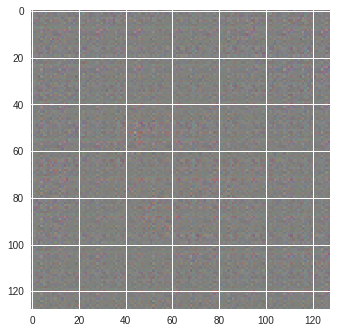

epoch:0,gloss:0.2592:   0%|          | 99/22511 [00:12<45:33,  8.20it/s]

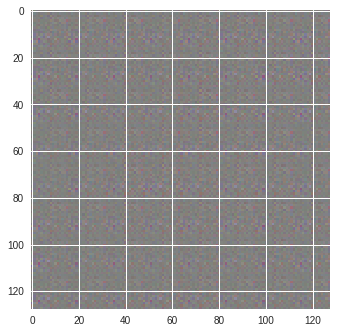

epoch:0,gloss:0.5153:   1%|          | 149/22511 [00:18<45:45,  8.15it/s]

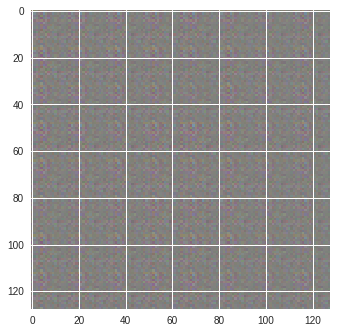

epoch:0,gloss:0.9653:   1%|          | 199/22511 [00:25<45:38,  8.15it/s]

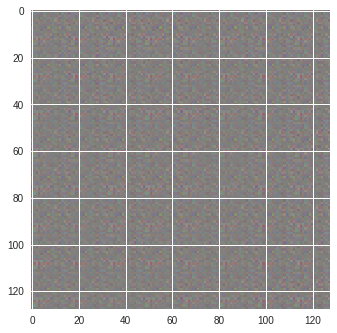

epoch:0,gloss:1.2841:   1%|          | 249/22511 [00:31<45:23,  8.17it/s]

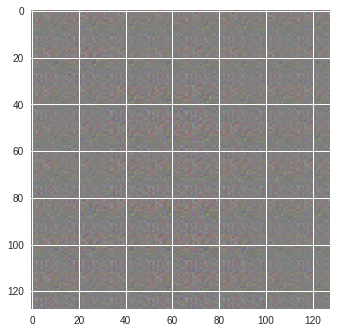

epoch:0,gloss:-0.8035:   1%|▏         | 299/22511 [00:37<45:18,  8.17it/s]

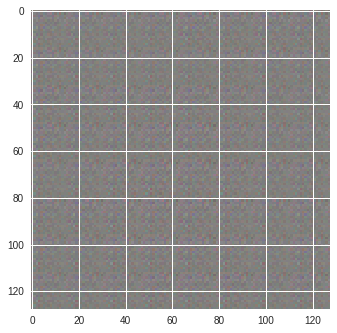

epoch:0,gloss:-0.6895:   2%|▏         | 349/22511 [00:44<45:28,  8.12it/s]

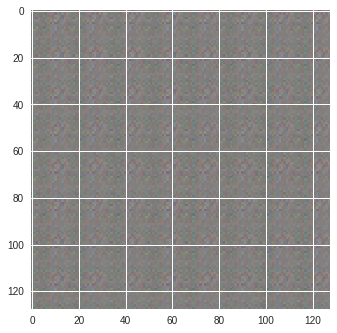

epoch:0,gloss:-3.9595:   2%|▏         | 399/22511 [00:50<45:15,  8.14it/s]

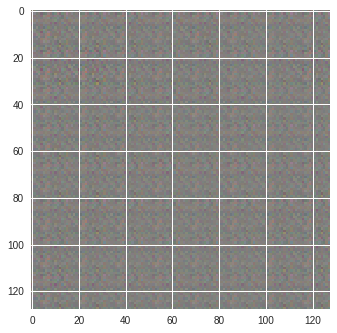

epoch:0,gloss:-0.8199:   2%|▏         | 449/22511 [00:57<45:35,  8.07it/s]

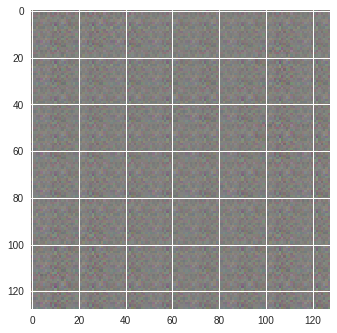

epoch:0,gloss:-1.8401:   2%|▏         | 499/22511 [01:03<44:02,  8.33it/s]

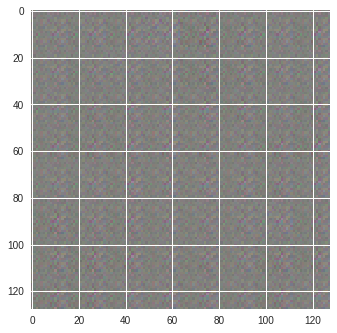

epoch:0,gloss:5.9107:   2%|▏         | 549/22511 [01:10<46:17,  7.91it/s]

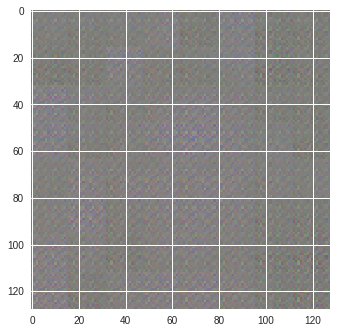

epoch:0,gloss:-0.6921:   3%|▎         | 599/22511 [01:16<46:15,  7.90it/s]

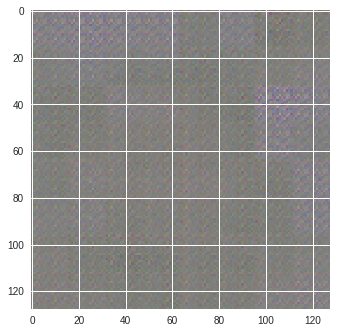

epoch:0,gloss:2.7604:   3%|▎         | 649/22511 [01:23<46:58,  7.76it/s]

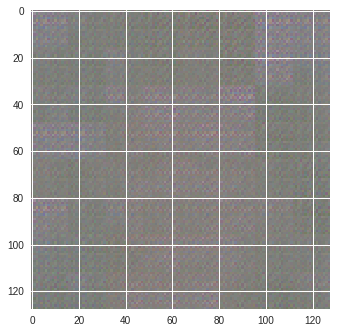

epoch:0,gloss:0.3884:   3%|▎         | 699/22511 [01:29<43:30,  8.36it/s]

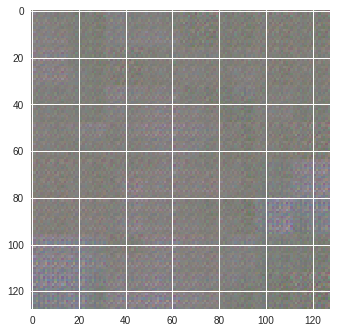

epoch:0,gloss:1.7598:   3%|▎         | 749/22511 [01:35<45:10,  8.03it/s]

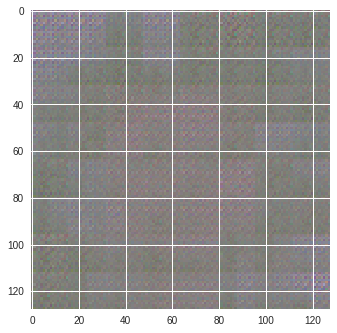

epoch:0,gloss:1.7351:   4%|▎         | 799/22511 [01:42<44:13,  8.18it/s]

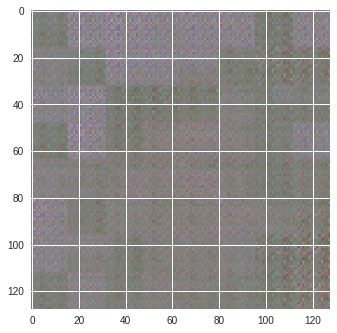

epoch:0,gloss:2.5612:   4%|▍         | 849/22511 [01:48<43:53,  8.22it/s]

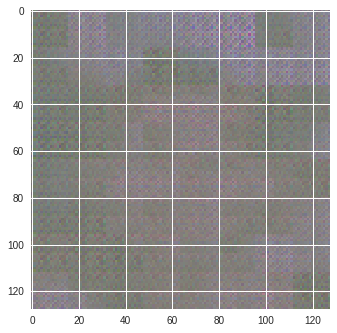

epoch:0,gloss:0.8888:   4%|▍         | 899/22511 [01:55<42:50,  8.41it/s]

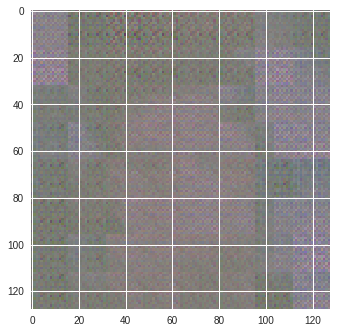

epoch:0,gloss:0.6148:   4%|▍         | 949/22511 [02:01<44:12,  8.13it/s]

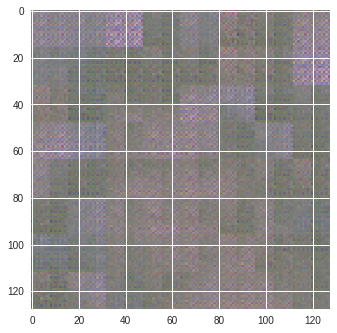

epoch:0,gloss:-0.1508:   4%|▍         | 999/22511 [02:07<44:16,  8.10it/s]

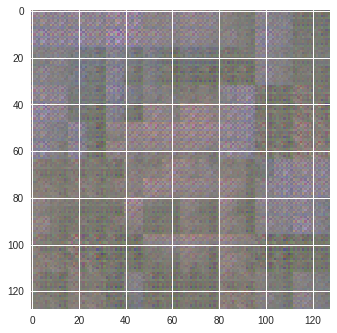

epoch:0,gloss:-1.3476:   5%|▍         | 1049/22511 [02:14<43:37,  8.20it/s]

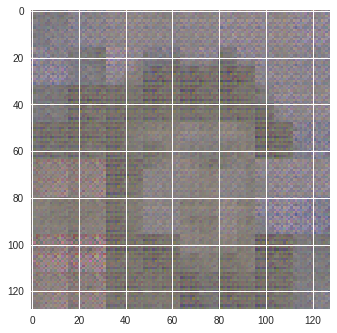

epoch:0,gloss:-0.4782:   5%|▍         | 1099/22511 [02:20<43:11,  8.26it/s]

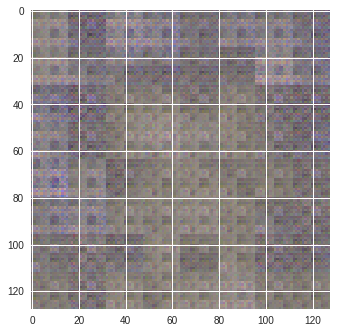

epoch:0,gloss:2.1298:   5%|▌         | 1149/22511 [02:26<42:38,  8.35it/s]

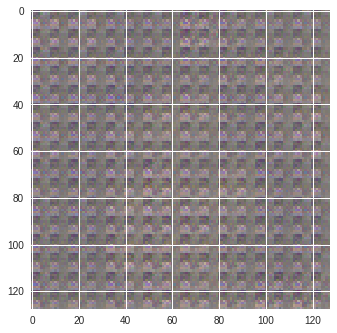

epoch:0,gloss:-0.8808:   5%|▌         | 1199/22511 [02:33<42:51,  8.29it/s]

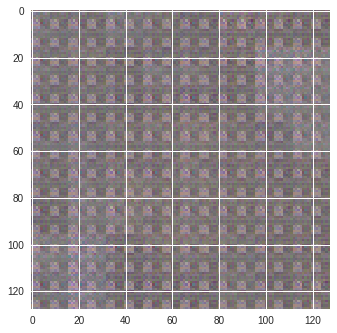

epoch:0,gloss:-0.4963:   6%|▌         | 1249/22511 [02:39<42:53,  8.26it/s]

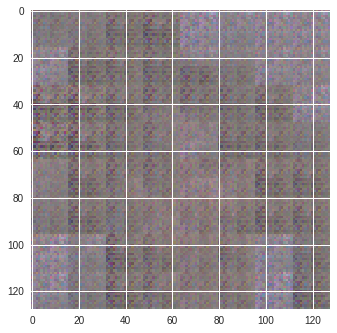

epoch:0,gloss:3.4966:   6%|▌         | 1299/22511 [02:45<43:24,  8.14it/s]

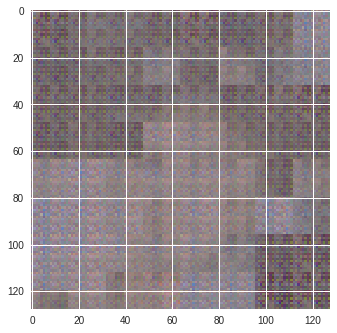

epoch:0,gloss:4.7268:   6%|▌         | 1349/22511 [02:52<42:40,  8.26it/s]

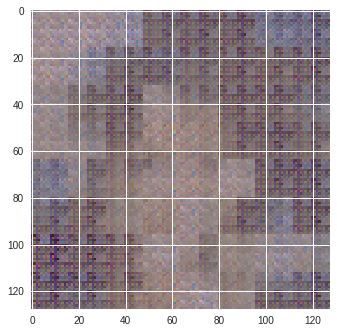

epoch:0,gloss:1.5844:   6%|▌         | 1399/22511 [02:58<44:03,  7.99it/s]

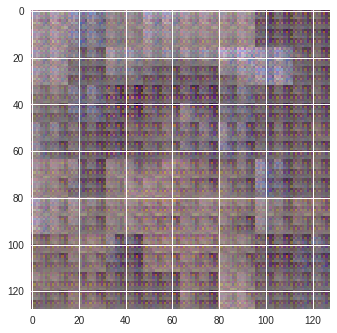

epoch:0,gloss:2.3746:   6%|▋         | 1449/22511 [03:04<42:49,  8.20it/s] 

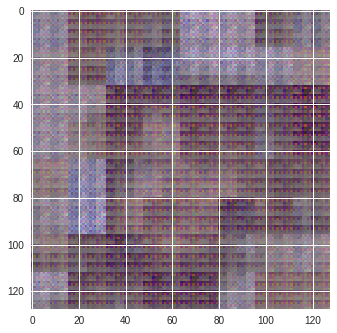

epoch:0,gloss:4.8473:   7%|▋         | 1499/22511 [03:11<42:46,  8.19it/s]

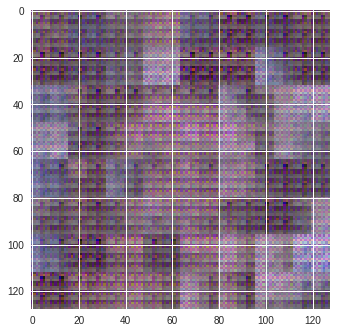

epoch:0,gloss:7.4038:   7%|▋         | 1549/22511 [03:17<43:03,  8.11it/s]

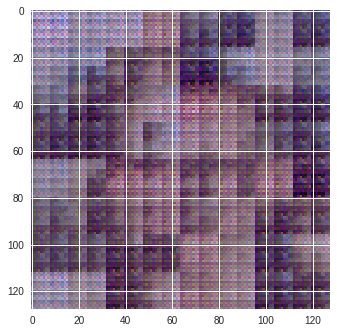

epoch:0,gloss:-0.2711:   7%|▋         | 1599/22511 [03:23<43:21,  8.04it/s]

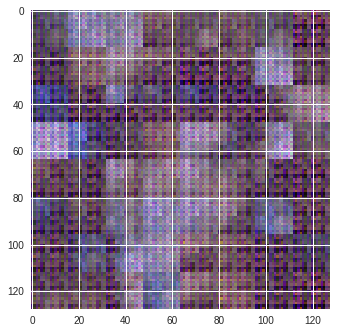

epoch:0,gloss:-0.3994:   7%|▋         | 1649/22511 [03:30<42:35,  8.16it/s]

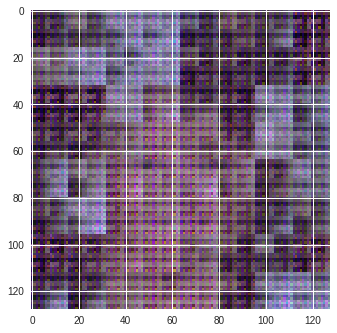

epoch:0,gloss:1.0876:   8%|▊         | 1699/22511 [03:36<41:59,  8.26it/s]

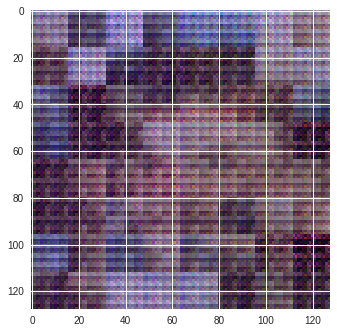

epoch:0,gloss:7.7000:   8%|▊         | 1749/22511 [03:42<42:05,  8.22it/s]

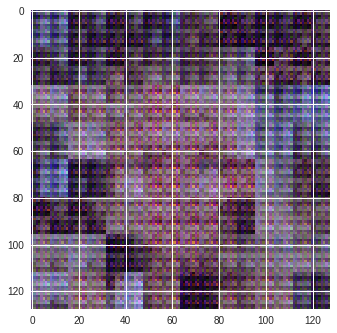

epoch:0,gloss:4.3432:   8%|▊         | 1799/22511 [03:49<43:27,  7.94it/s]

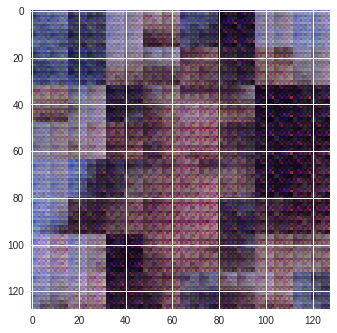

epoch:0,gloss:-2.6012:   8%|▊         | 1849/22511 [03:55<41:51,  8.23it/s]

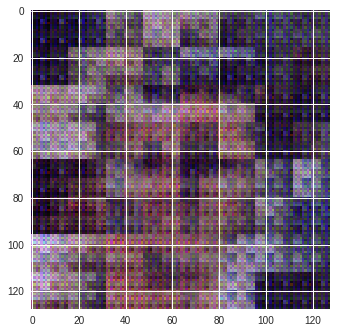

epoch:0,gloss:-0.3668:   8%|▊         | 1899/22511 [04:01<40:23,  8.50it/s]

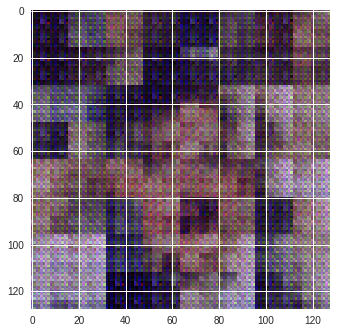

epoch:0,gloss:-1.8649:   9%|▊         | 1949/22511 [04:08<42:29,  8.07it/s]

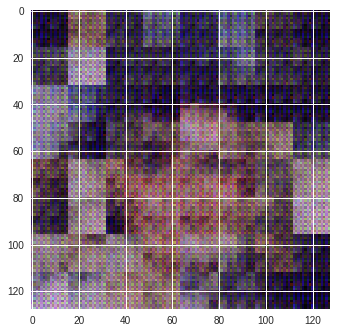

epoch:0,gloss:2.6806:   9%|▉         | 1999/22511 [04:14<41:04,  8.32it/s]

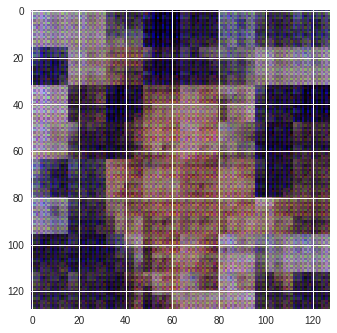

epoch:0,gloss:5.1218:   9%|▉         | 2049/22511 [04:20<41:49,  8.15it/s]

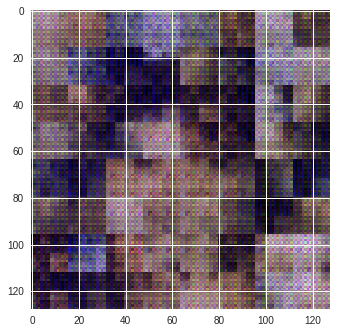

epoch:0,gloss:4.9251:   9%|▉         | 2099/22511 [04:27<41:21,  8.23it/s]

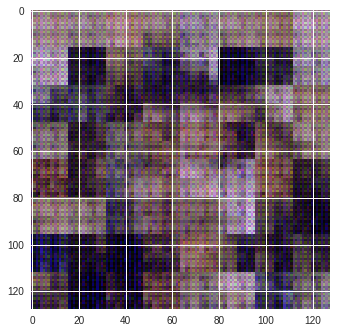

epoch:0,gloss:3.3959:  10%|▉         | 2149/22511 [04:33<41:35,  8.16it/s]

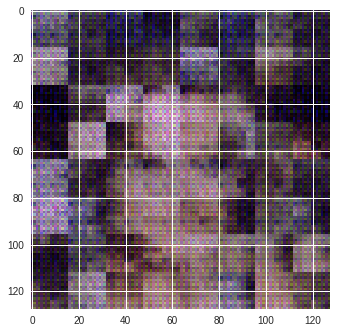

epoch:0,gloss:1.9092:  10%|▉         | 2199/22511 [04:39<40:38,  8.33it/s]

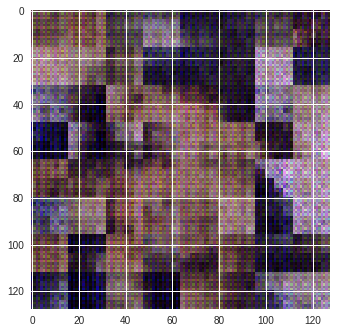

epoch:0,gloss:4.5979:  10%|▉         | 2249/22511 [04:46<40:59,  8.24it/s]

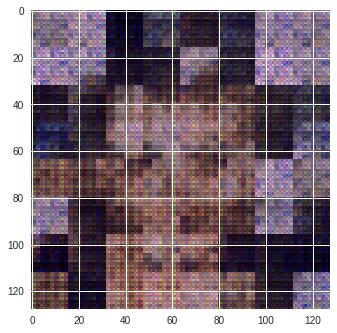

epoch:0,gloss:4.7778:  10%|█         | 2299/22511 [04:52<40:59,  8.22it/s]

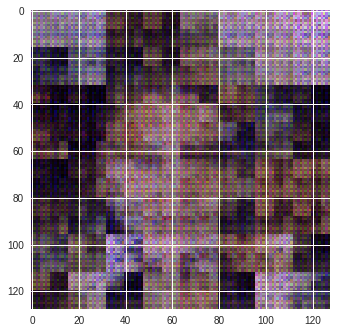

epoch:0,gloss:6.6775:  10%|█         | 2349/22511 [04:58<40:36,  8.28it/s]

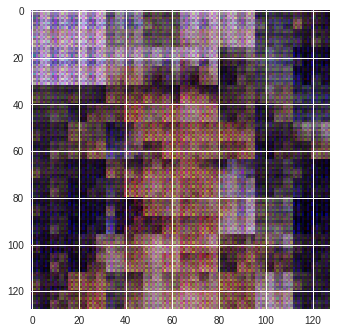

epoch:0,gloss:8.1081:  11%|█         | 2399/22511 [05:05<40:37,  8.25it/s]

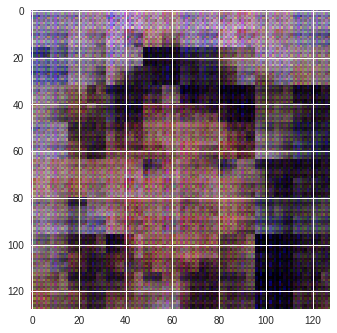

epoch:0,gloss:9.0174:  11%|█         | 2449/22511 [05:11<40:30,  8.26it/s]

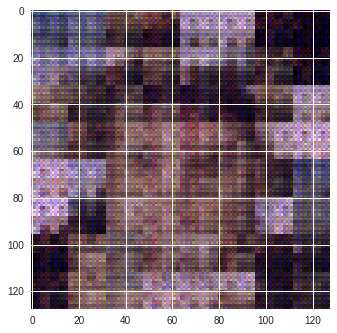

epoch:0,gloss:5.5502:  11%|█         | 2499/22511 [05:17<39:40,  8.41it/s]

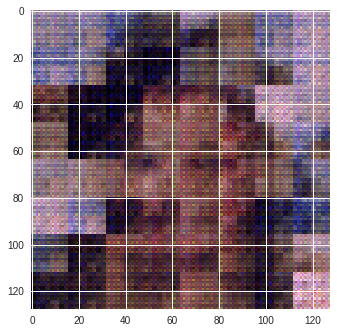

epoch:0,gloss:1.2156:  11%|█▏        | 2549/22511 [05:24<41:06,  8.09it/s]

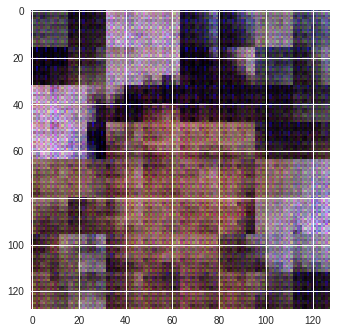

epoch:0,gloss:2.3938:  12%|█▏        | 2599/22511 [05:30<40:19,  8.23it/s]

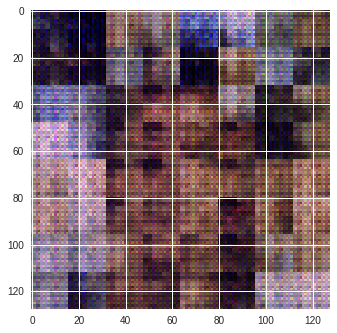

epoch:0,gloss:7.0925:  12%|█▏        | 2649/22511 [05:36<40:21,  8.20it/s]

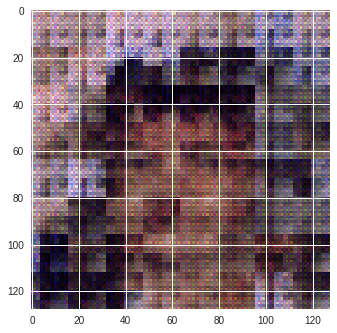

epoch:0,gloss:4.2950:  12%|█▏        | 2699/22511 [05:43<39:46,  8.30it/s]

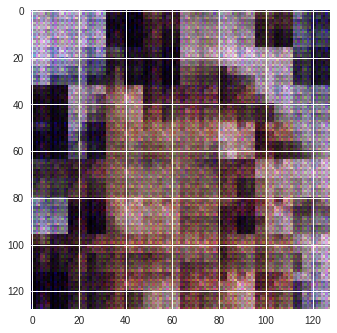

epoch:0,gloss:-2.3706:  12%|█▏        | 2749/22511 [05:49<38:46,  8.49it/s]

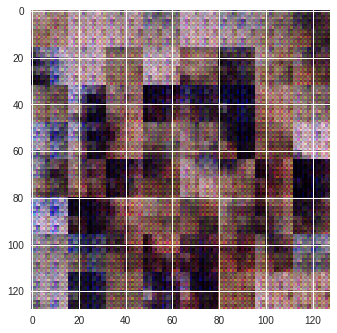

epoch:0,gloss:-5.0544:  12%|█▏        | 2799/22511 [05:55<39:17,  8.36it/s]

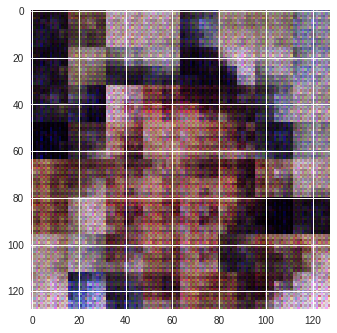

epoch:0,gloss:4.5098:  13%|█▎        | 2849/22511 [06:01<38:36,  8.49it/s]

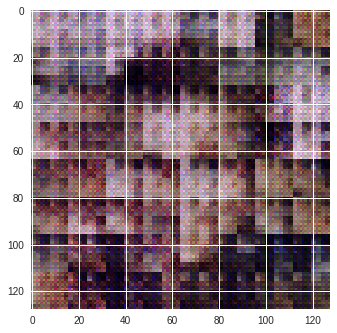

epoch:0,gloss:-1.2346:  13%|█▎        | 2899/22511 [06:08<39:39,  8.24it/s]

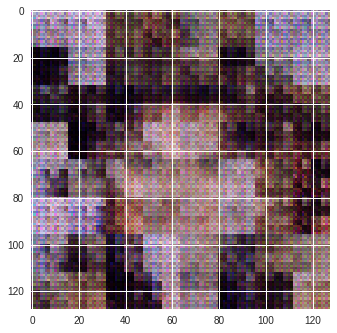

epoch:0,gloss:8.2954:  13%|█▎        | 2949/22511 [06:14<38:57,  8.37it/s]

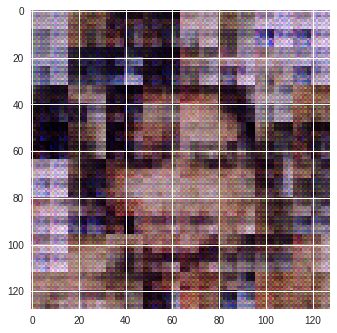

epoch:0,gloss:5.1988:  13%|█▎        | 2999/22511 [06:20<38:08,  8.52it/s]

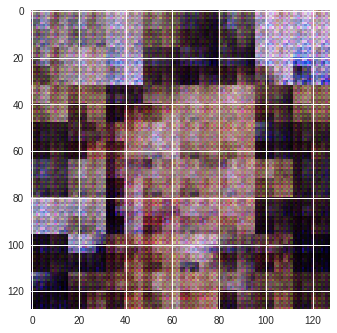

epoch:0,gloss:-4.1405:  14%|█▎        | 3049/22511 [06:26<38:51,  8.35it/s]

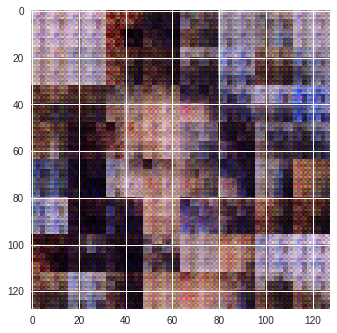

epoch:0,gloss:4.0489:  14%|█▍        | 3099/22511 [06:33<38:33,  8.39it/s]

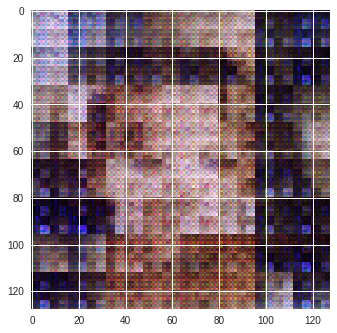

epoch:0,gloss:6.5832:  14%|█▍        | 3149/22511 [06:39<38:11,  8.45it/s]

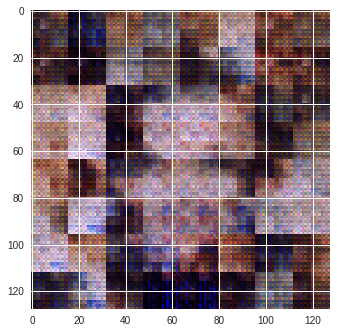

epoch:0,gloss:6.1759:  14%|█▍        | 3199/22511 [06:45<37:56,  8.48it/s]

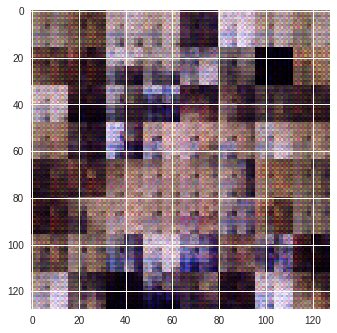

epoch:0,gloss:1.8977:  14%|█▍        | 3249/22511 [06:51<38:09,  8.41it/s]

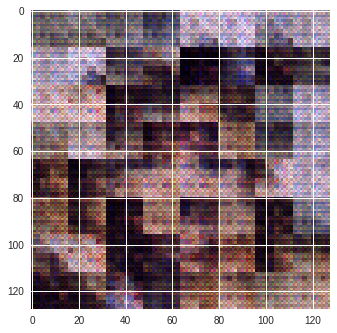

epoch:0,gloss:4.2210:  15%|█▍        | 3299/22511 [06:57<37:28,  8.54it/s]

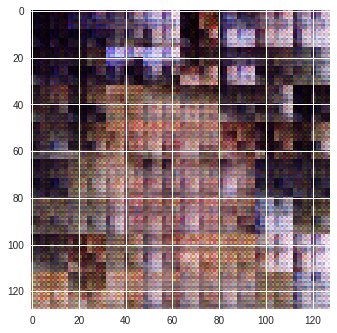

epoch:0,gloss:-1.5174:  15%|█▍        | 3349/22511 [07:04<37:58,  8.41it/s]

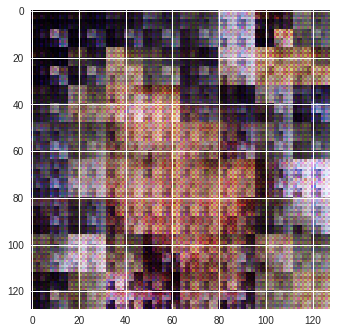

epoch:0,gloss:3.7765:  15%|█▌        | 3399/22511 [07:10<38:24,  8.29it/s]

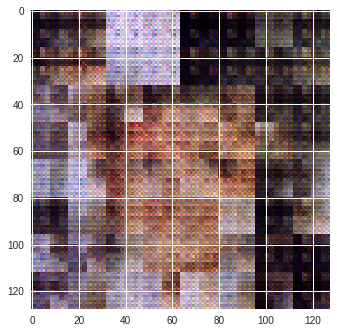

epoch:0,gloss:-2.4576:  15%|█▌        | 3449/22511 [07:16<37:40,  8.43it/s]

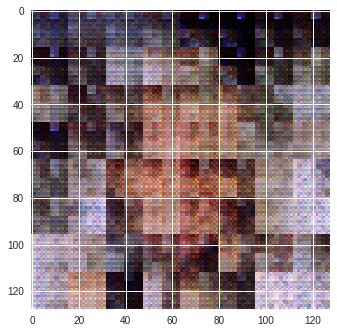

epoch:0,gloss:1.5652:  16%|█▌        | 3499/22511 [07:22<37:12,  8.51it/s] 

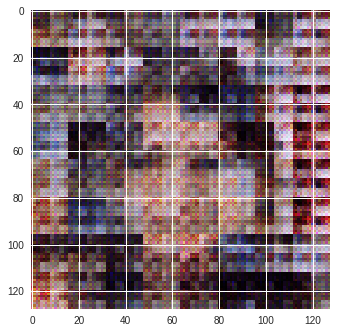

epoch:0,gloss:2.7616:  16%|█▌        | 3549/22511 [07:28<38:24,  8.23it/s]

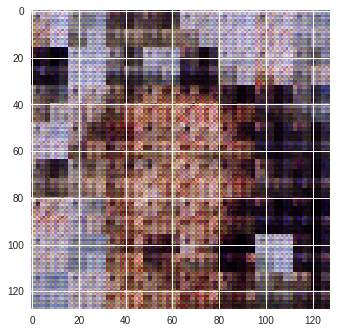

epoch:0,gloss:2.3945:  16%|█▌        | 3599/22511 [07:35<36:47,  8.57it/s]

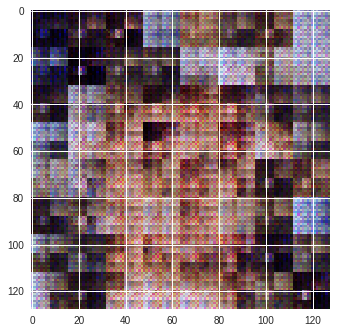

epoch:0,gloss:3.7909:  16%|█▌        | 3649/22511 [07:41<36:59,  8.50it/s]

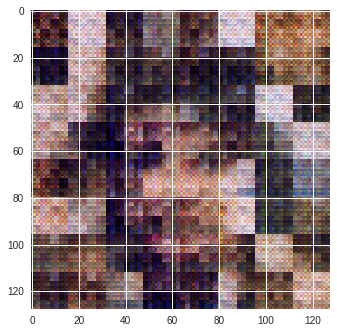

epoch:0,gloss:2.3518:  16%|█▋        | 3699/22511 [07:47<37:14,  8.42it/s]

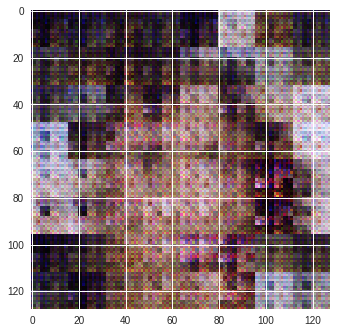

epoch:0,gloss:5.9385:  17%|█▋        | 3749/22511 [07:53<36:28,  8.57it/s]

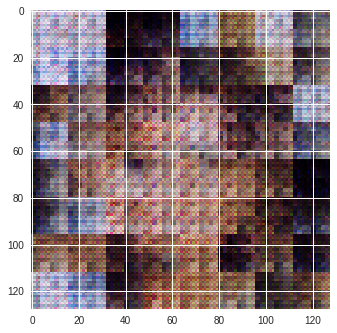

epoch:0,gloss:5.2965:  17%|█▋        | 3799/22511 [07:59<35:29,  8.79it/s]

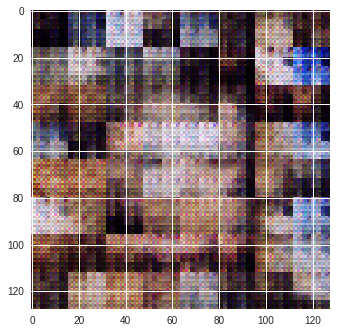

epoch:0,gloss:6.5313:  17%|█▋        | 3849/22511 [08:05<35:23,  8.79it/s]

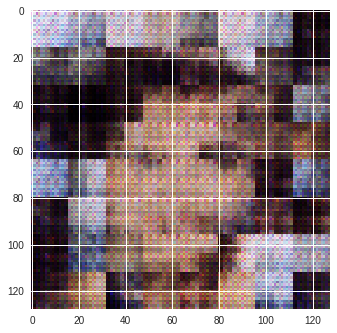

epoch:0,gloss:6.3872:  17%|█▋        | 3899/22511 [08:11<36:51,  8.42it/s]

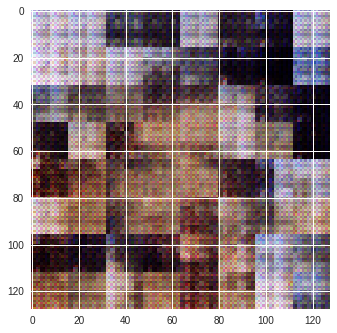

epoch:0,gloss:-8.0866:  18%|█▊        | 3949/22511 [08:17<36:05,  8.57it/s]

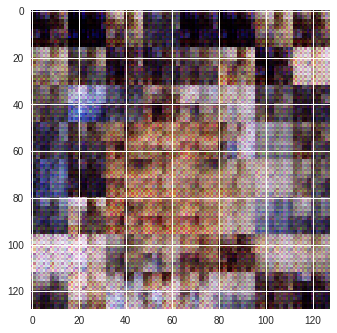

epoch:0,gloss:5.8784:  18%|█▊        | 3999/22511 [08:23<36:25,  8.47it/s]

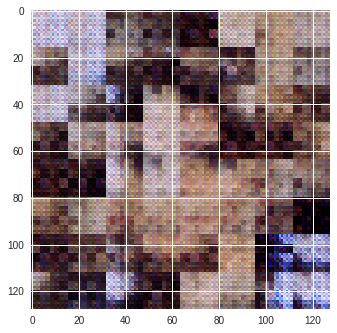

epoch:0,gloss:0.7276:  18%|█▊        | 4049/22511 [08:30<36:16,  8.48it/s] 

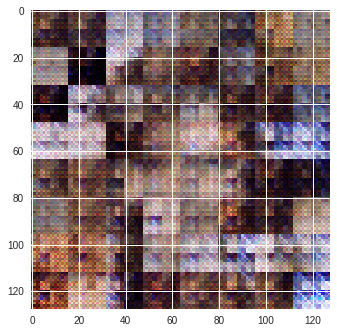

epoch:0,gloss:5.0328:  18%|█▊        | 4099/22511 [08:36<35:46,  8.58it/s]

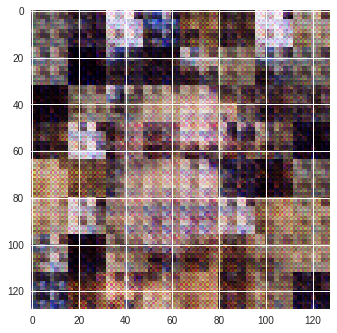

epoch:0,gloss:7.3571:  18%|█▊        | 4149/22511 [08:42<35:18,  8.67it/s]

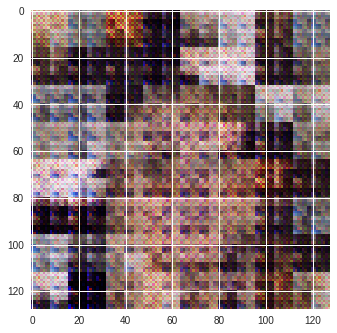

epoch:0,gloss:-1.1287:  19%|█▊        | 4199/22511 [08:48<36:18,  8.41it/s]

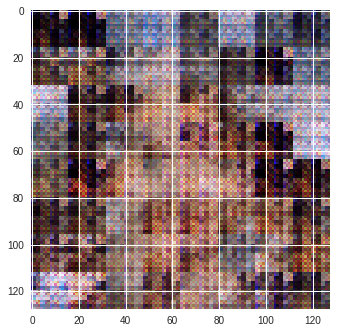

epoch:0,gloss:-1.0087:  19%|█▉        | 4249/22511 [08:54<35:31,  8.57it/s]

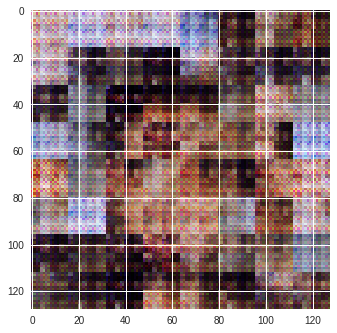

epoch:0,gloss:7.1303:  19%|█▉        | 4299/22511 [09:00<35:26,  8.57it/s]

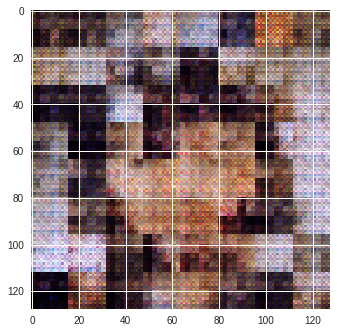

epoch:0,gloss:5.6456:  19%|█▉        | 4349/22511 [09:07<35:19,  8.57it/s]

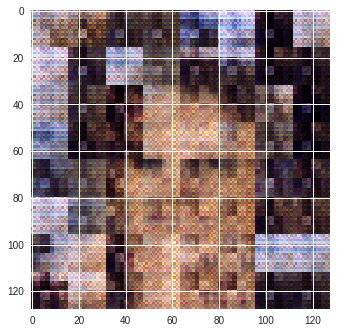

epoch:0,gloss:0.0153:  20%|█▉        | 4399/22511 [09:13<34:52,  8.66it/s] 

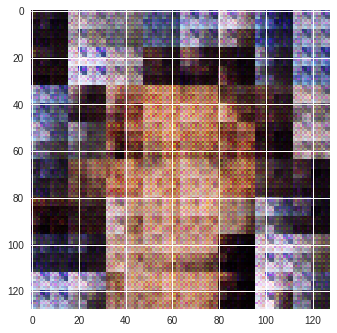

epoch:0,gloss:-4.7916:  20%|█▉        | 4449/22511 [09:19<35:37,  8.45it/s]

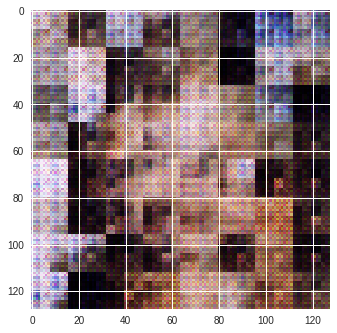

epoch:0,gloss:14.7555:  20%|█▉        | 4499/22511 [09:25<35:44,  8.40it/s]

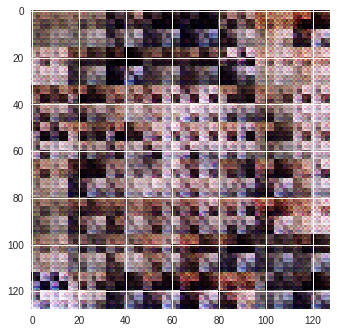

epoch:0,gloss:-7.8044:  20%|██        | 4549/22511 [09:31<35:50,  8.35it/s]

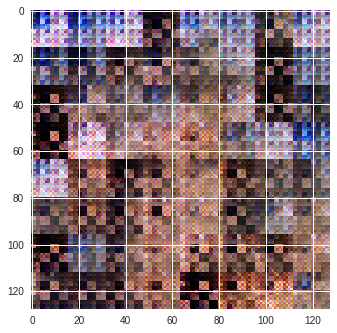

epoch:0,gloss:0.7278:  20%|██        | 4599/22511 [09:37<34:04,  8.76it/s]

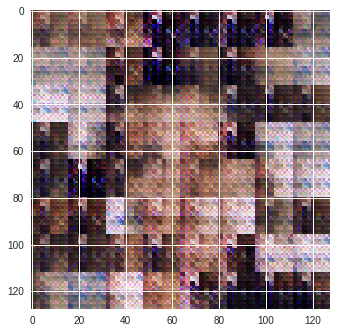

epoch:0,gloss:-2.7680:  21%|██        | 4649/22511 [09:43<34:40,  8.59it/s]

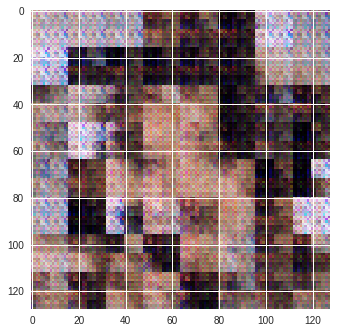

epoch:0,gloss:3.8751:  21%|██        | 4699/22511 [09:49<34:00,  8.73it/s]

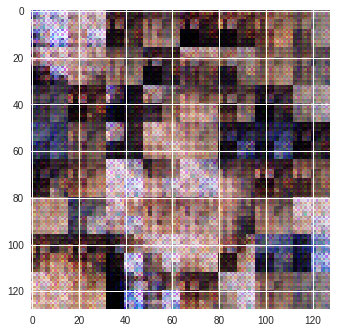

epoch:0,gloss:2.6049:  21%|██        | 4749/22511 [09:55<34:26,  8.60it/s]

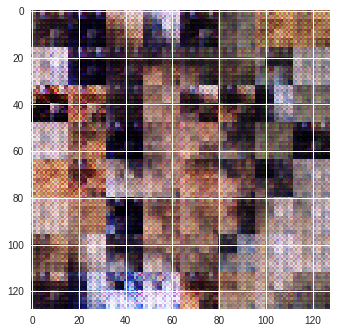

epoch:0,gloss:8.8871:  21%|██▏       | 4799/22511 [10:01<33:58,  8.69it/s]

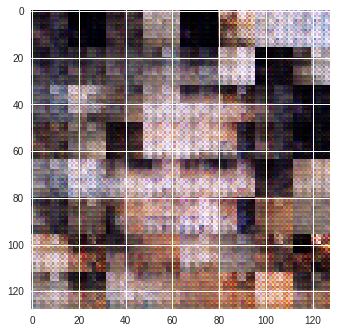

epoch:0,gloss:3.6403:  22%|██▏       | 4849/22511 [10:07<35:13,  8.36it/s]

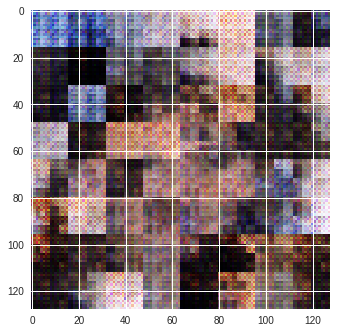

epoch:0,gloss:-3.4499:  22%|██▏       | 4899/22511 [10:14<34:16,  8.56it/s]

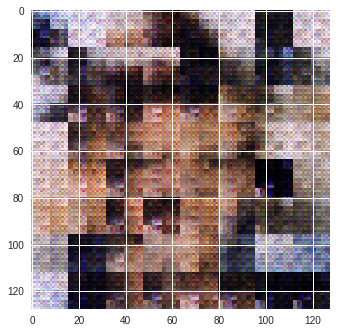

epoch:0,gloss:10.8955:  22%|██▏       | 4949/22511 [10:20<34:39,  8.44it/s]

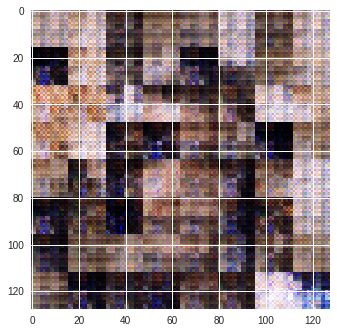

epoch:0,gloss:6.0628:  22%|██▏       | 4999/22511 [10:26<34:53,  8.36it/s]

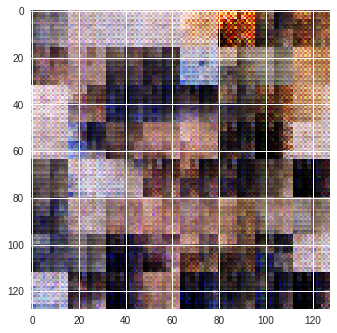

epoch:0,gloss:5.2369:  22%|██▏       | 5049/22511 [10:32<34:03,  8.55it/s]

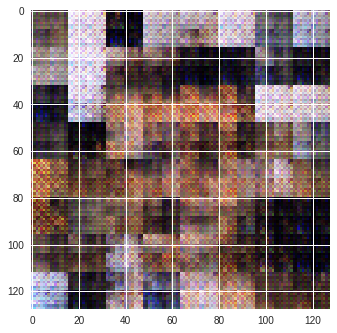

epoch:0,gloss:5.7641:  23%|██▎       | 5099/22511 [10:38<32:52,  8.83it/s]

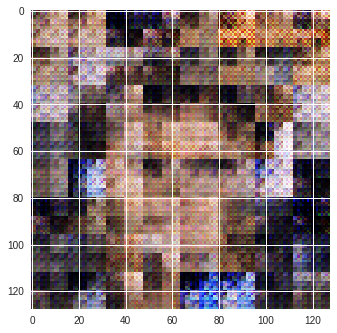

epoch:0,gloss:5.3672:  23%|██▎       | 5149/22511 [10:44<33:52,  8.54it/s]

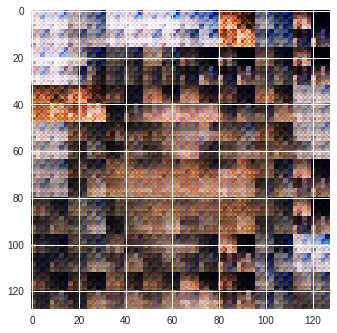

epoch:0,gloss:12.3772:  23%|██▎       | 5199/22511 [10:50<33:01,  8.73it/s]

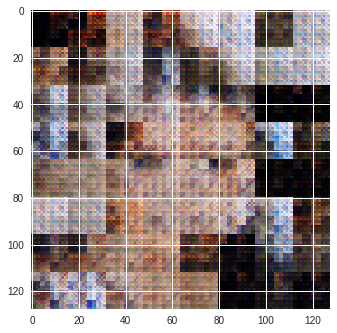

epoch:0,gloss:7.4090:  23%|██▎       | 5249/22511 [10:56<33:39,  8.55it/s]

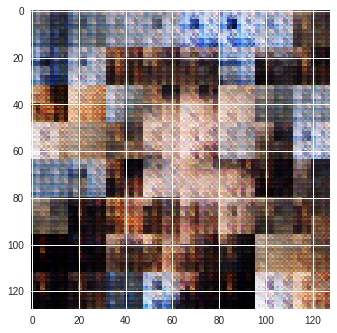

epoch:0,gloss:9.9999:  24%|██▎       | 5299/22511 [11:02<33:01,  8.68it/s]

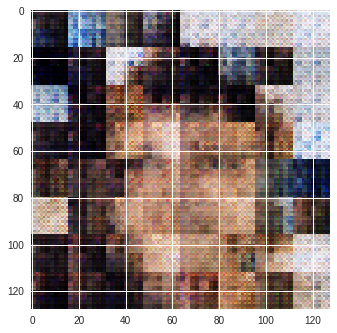

epoch:0,gloss:2.4457:  24%|██▍       | 5349/22511 [11:08<32:53,  8.70it/s]

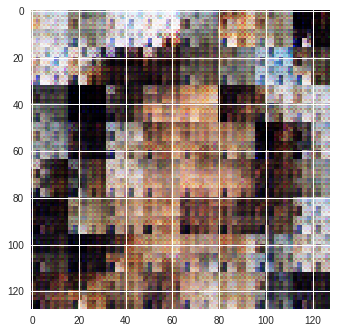

epoch:0,gloss:3.0507:  24%|██▍       | 5399/22511 [11:14<33:06,  8.61it/s]

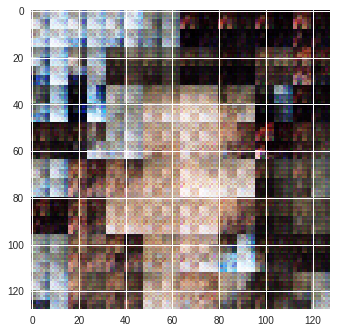

epoch:0,gloss:1.9365:  24%|██▍       | 5449/22511 [11:20<33:27,  8.50it/s]

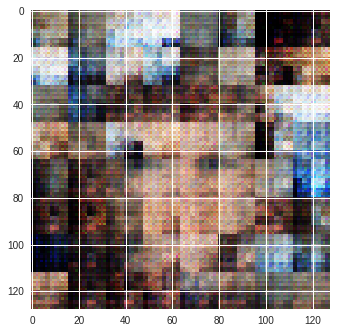

epoch:0,gloss:3.7485:  24%|██▍       | 5499/22511 [11:26<33:29,  8.47it/s]

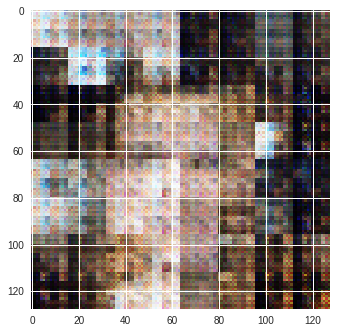

epoch:0,gloss:10.9139:  25%|██▍       | 5549/22511 [11:32<32:32,  8.69it/s]

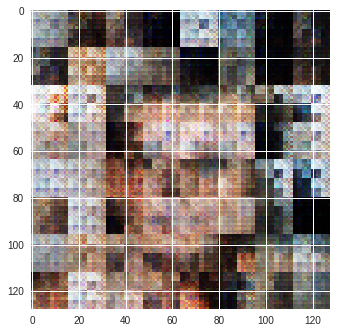

epoch:0,gloss:8.8042:  25%|██▍       | 5599/22511 [11:39<32:48,  8.59it/s]

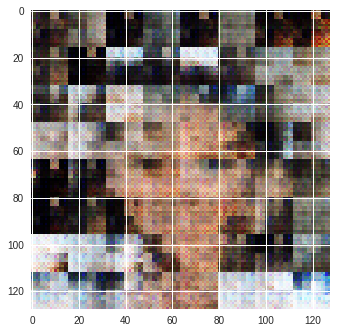

epoch:0,gloss:7.6493:  25%|██▌       | 5649/22511 [11:45<32:05,  8.76it/s]

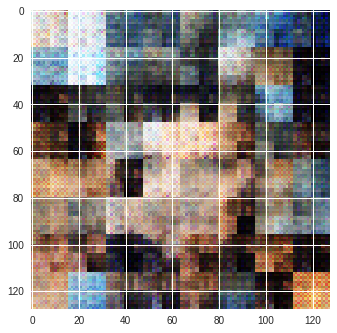

epoch:0,gloss:5.6937:  25%|██▌       | 5699/22511 [11:51<32:00,  8.75it/s]

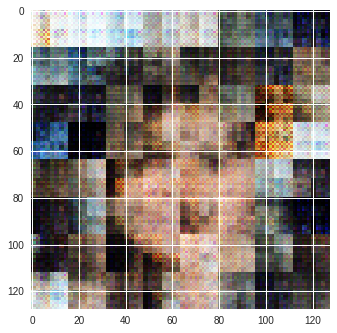

epoch:0,gloss:4.1553:  26%|██▌       | 5749/22511 [11:57<32:11,  8.68it/s]

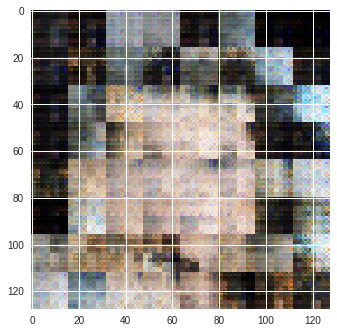

epoch:0,gloss:8.8453:  26%|██▌       | 5799/22511 [12:03<32:54,  8.46it/s]

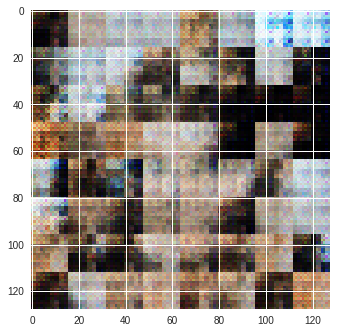

epoch:0,gloss:4.2214:  26%|██▌       | 5849/22511 [12:09<32:18,  8.59it/s]

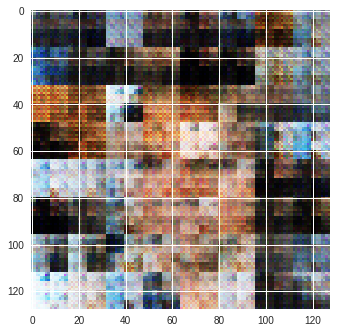

epoch:0,gloss:4.9852:  26%|██▌       | 5899/22511 [12:15<31:44,  8.72it/s]

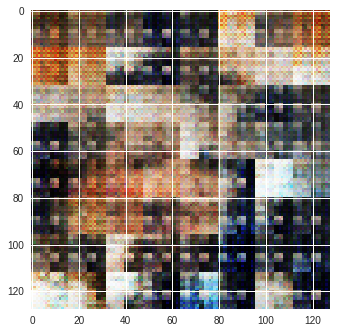

epoch:0,gloss:6.9334:  26%|██▋       | 5949/22511 [12:21<31:06,  8.87it/s]

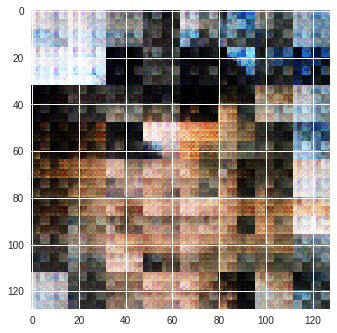

epoch:0,gloss:9.4797:  27%|██▋       | 5999/22511 [12:27<30:51,  8.92it/s]

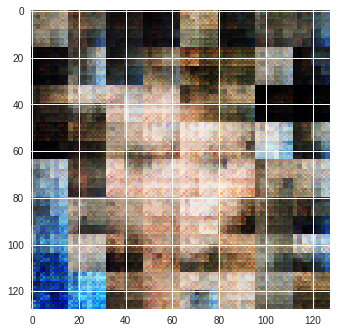

epoch:0,gloss:4.4008:  27%|██▋       | 6049/22511 [12:33<32:29,  8.44it/s]

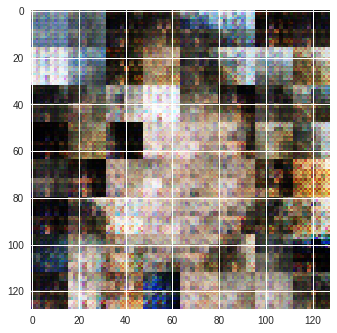

epoch:0,gloss:-0.0228:  27%|██▋       | 6099/22511 [12:39<31:34,  8.66it/s]

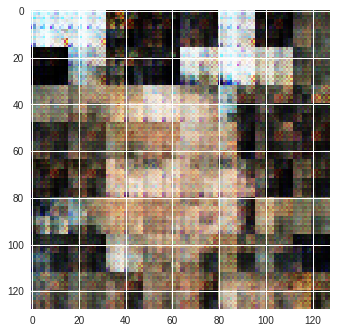

epoch:0,gloss:5.5555:  27%|██▋       | 6149/22511 [12:45<31:15,  8.72it/s]

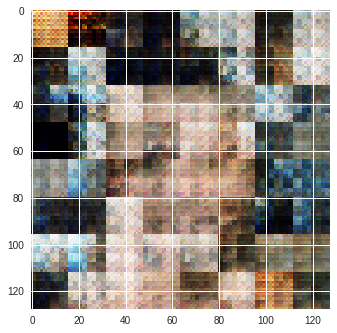

epoch:0,gloss:1.0506:  28%|██▊       | 6199/22511 [12:51<31:31,  8.62it/s]

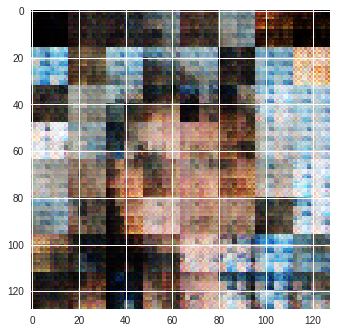

epoch:0,gloss:1.4203:  28%|██▊       | 6249/22511 [12:57<30:26,  8.90it/s]

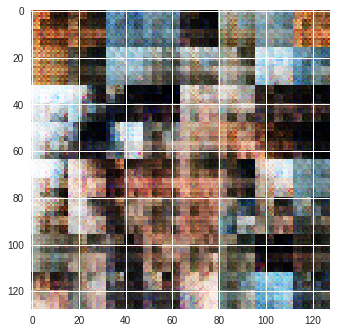

epoch:0,gloss:13.4116:  28%|██▊       | 6299/22511 [13:03<30:23,  8.89it/s]

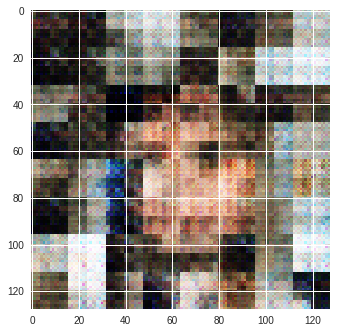

epoch:0,gloss:7.9568:  28%|██▊       | 6349/22511 [13:09<31:09,  8.65it/s]

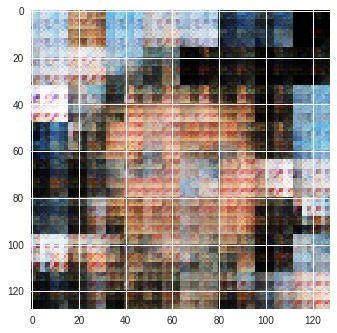

epoch:0,gloss:8.4469:  28%|██▊       | 6399/22511 [13:15<31:18,  8.58it/s] 

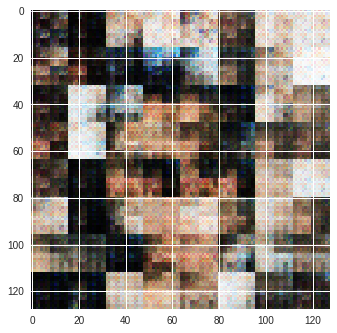

epoch:0,gloss:4.5894:  29%|██▊       | 6449/22511 [13:21<30:49,  8.68it/s]

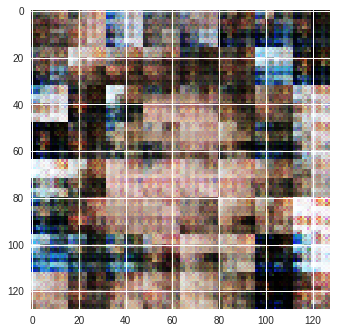

epoch:0,gloss:7.7172:  29%|██▉       | 6499/22511 [13:27<30:57,  8.62it/s]

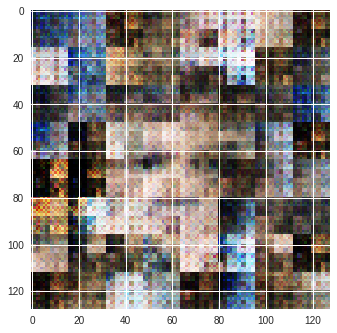

epoch:0,gloss:9.7405:  29%|██▉       | 6549/22511 [13:33<30:55,  8.60it/s] 

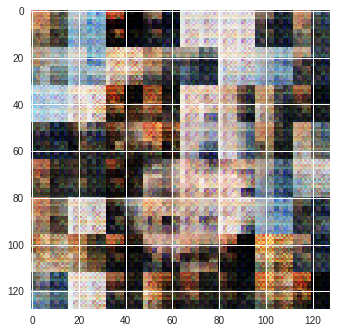

epoch:0,gloss:5.8973:  29%|██▉       | 6599/22511 [13:39<30:31,  8.69it/s]

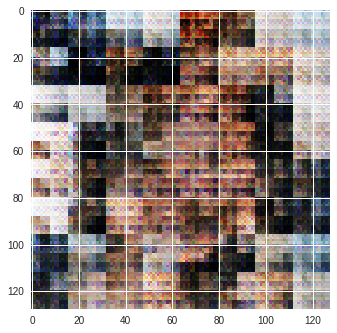

epoch:0,gloss:10.4134:  30%|██▉       | 6649/22511 [13:45<30:56,  8.54it/s]

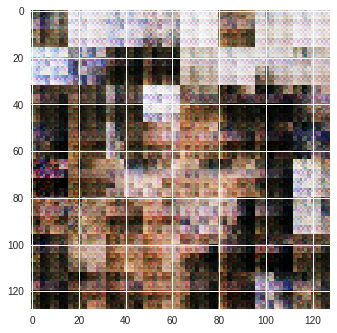

epoch:0,gloss:4.6701:  30%|██▉       | 6699/22511 [13:51<29:41,  8.88it/s]

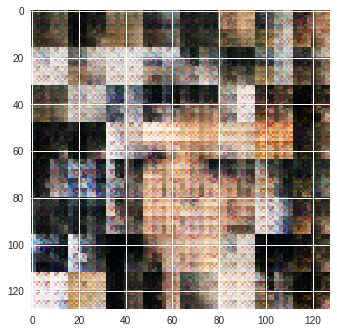

epoch:0,gloss:5.7530:  30%|██▉       | 6749/22511 [13:57<29:41,  8.85it/s]

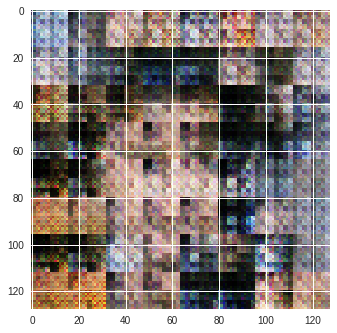

epoch:0,gloss:3.0336:  30%|███       | 6799/22511 [14:03<29:59,  8.73it/s]

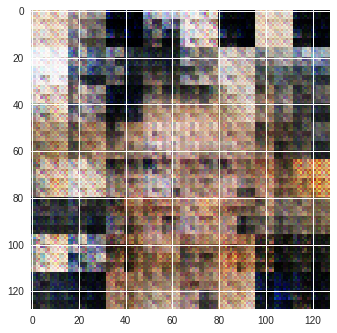

epoch:0,gloss:14.5697:  30%|███       | 6849/22511 [14:09<32:20,  8.07it/s]

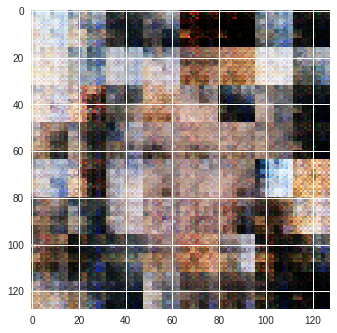

epoch:0,gloss:6.4570:  31%|███       | 6899/22511 [14:15<29:39,  8.77it/s]

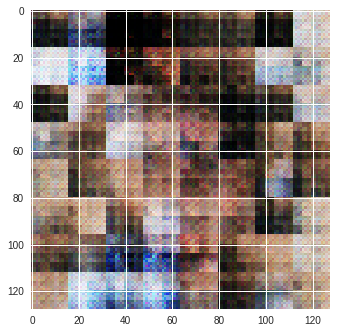

epoch:0,gloss:6.1866:  31%|███       | 6949/22511 [14:21<29:56,  8.66it/s]

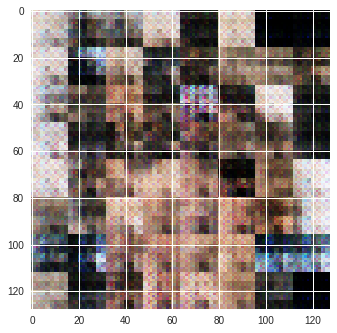

epoch:0,gloss:12.1061:  31%|███       | 6999/22511 [14:27<28:53,  8.95it/s]

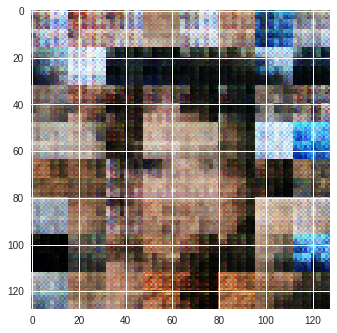

epoch:0,gloss:6.1002:  31%|███▏      | 7049/22511 [14:33<29:02,  8.87it/s]

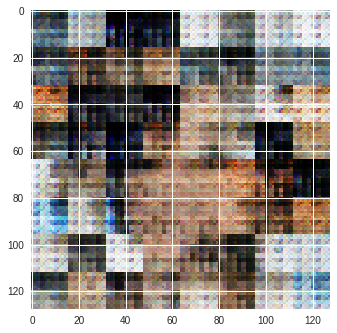

epoch:0,gloss:1.1213:  32%|███▏      | 7099/22511 [14:39<28:46,  8.93it/s] 

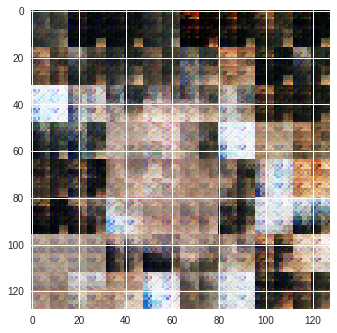

epoch:0,gloss:12.1367:  32%|███▏      | 7149/22511 [14:45<29:46,  8.60it/s]

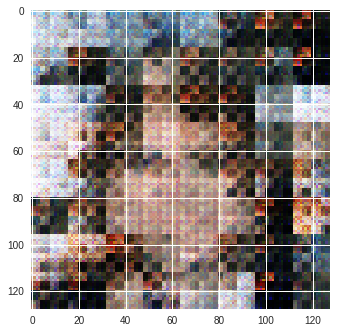

epoch:0,gloss:10.0215:  32%|███▏      | 7199/22511 [14:51<30:13,  8.44it/s]

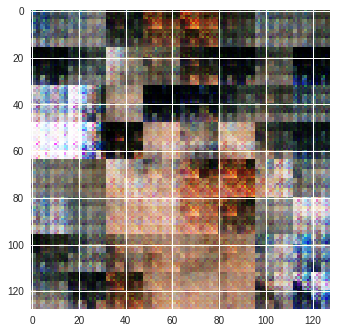

epoch:0,gloss:6.7671:  32%|███▏      | 7249/22511 [14:56<28:39,  8.87it/s]

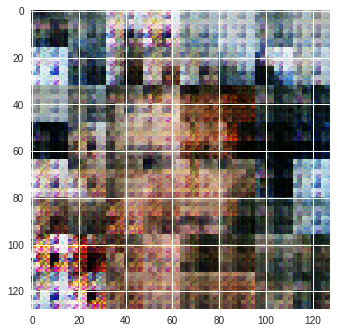

epoch:0,gloss:6.1952:  32%|███▏      | 7299/22511 [15:02<29:15,  8.66it/s]

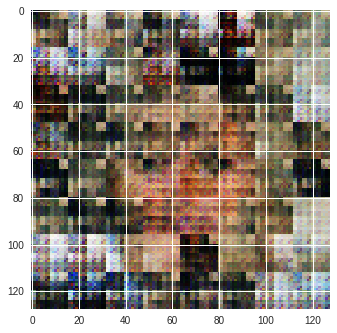

epoch:0,gloss:9.2503:  33%|███▎      | 7349/22511 [15:08<28:57,  8.72it/s]

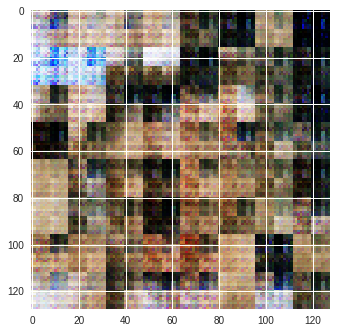

epoch:0,gloss:11.1456:  33%|███▎      | 7399/22511 [15:14<29:37,  8.50it/s]

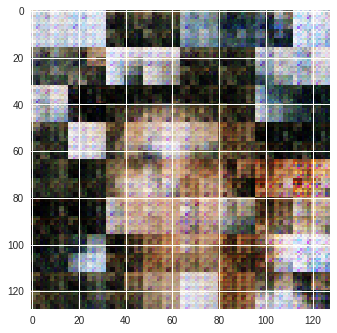

epoch:0,gloss:11.2858:  33%|███▎      | 7449/22511 [15:20<27:58,  8.98it/s]

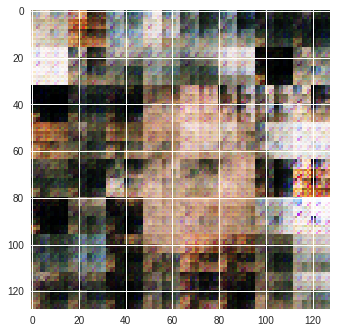

epoch:0,gloss:13.5959:  33%|███▎      | 7499/22511 [15:26<28:00,  8.93it/s]

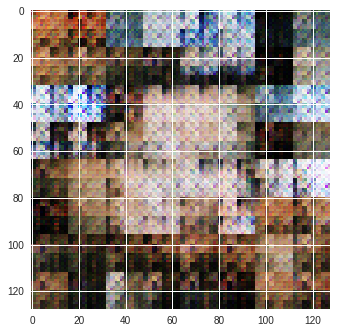

epoch:0,gloss:8.2717:  34%|███▎      | 7549/22511 [15:32<28:03,  8.89it/s]

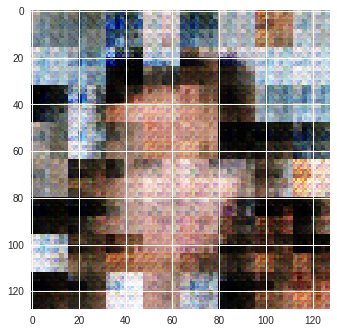

epoch:0,gloss:7.0953:  34%|███▍      | 7599/22511 [15:38<27:54,  8.90it/s]

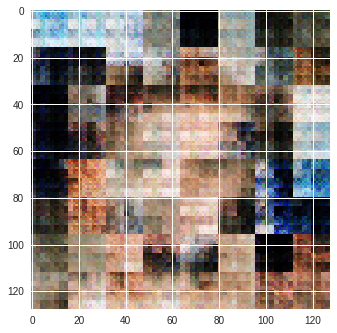

epoch:0,gloss:6.9487:  34%|███▍      | 7649/22511 [15:44<27:39,  8.95it/s]

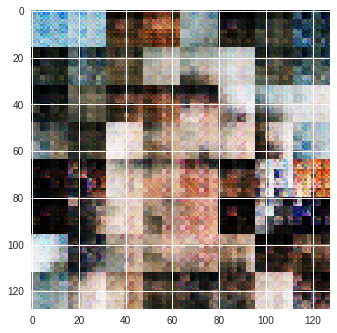

epoch:0,gloss:9.6813:  34%|███▍      | 7699/22511 [15:50<28:16,  8.73it/s]

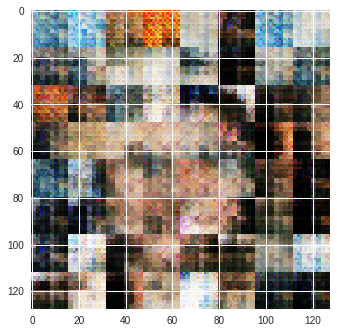

epoch:0,gloss:12.6520:  34%|███▍      | 7749/22511 [15:56<27:47,  8.85it/s]

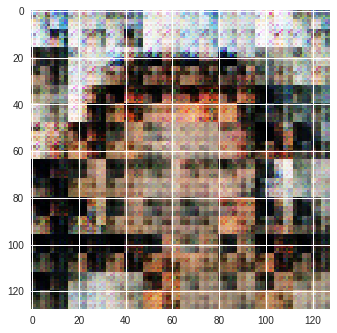

epoch:0,gloss:1.1345:  35%|███▍      | 7799/22511 [16:02<26:53,  9.12it/s]

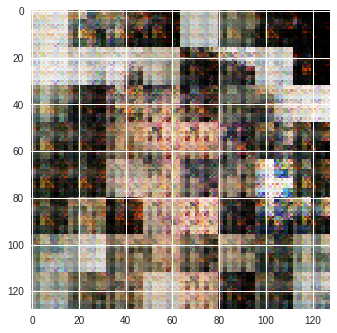

epoch:0,gloss:8.7018:  35%|███▍      | 7849/22511 [16:08<27:50,  8.78it/s]

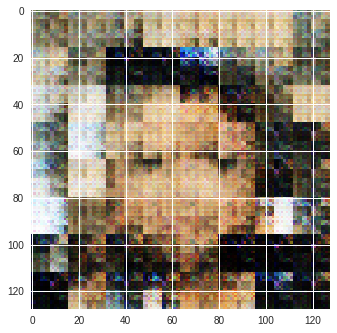

epoch:0,gloss:-0.1227:  35%|███▌      | 7899/22511 [16:14<26:47,  9.09it/s]

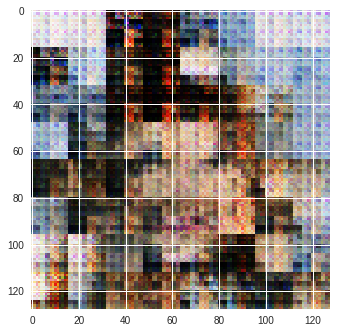

epoch:0,gloss:9.1190:  35%|███▌      | 7949/22511 [16:20<27:18,  8.89it/s]

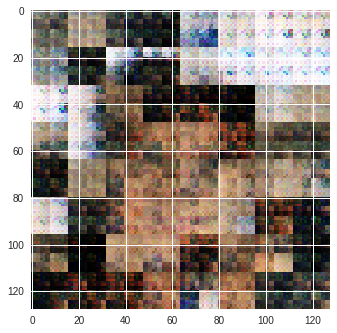

epoch:0,gloss:5.1734:  36%|███▌      | 7999/22511 [16:25<28:03,  8.62it/s]

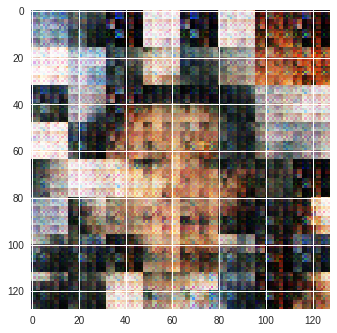

epoch:0,gloss:6.7102:  36%|███▌      | 8049/22511 [16:31<27:11,  8.86it/s]

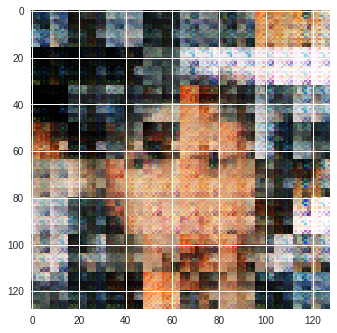

epoch:0,gloss:1.9445:  36%|███▌      | 8099/22511 [16:37<27:08,  8.85it/s]

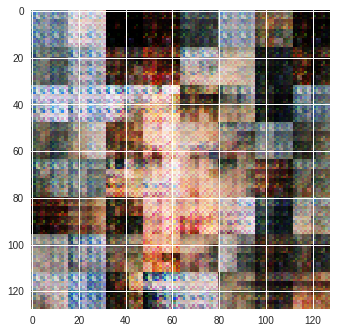

epoch:0,gloss:7.9734:  36%|███▌      | 8149/22511 [16:43<27:13,  8.79it/s]

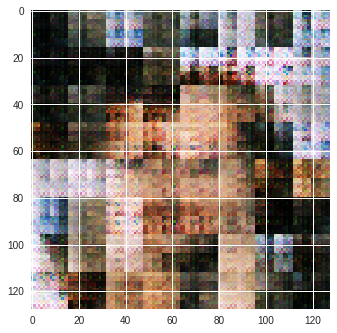

epoch:0,gloss:3.5742:  36%|███▋      | 8199/22511 [16:49<27:57,  8.53it/s]

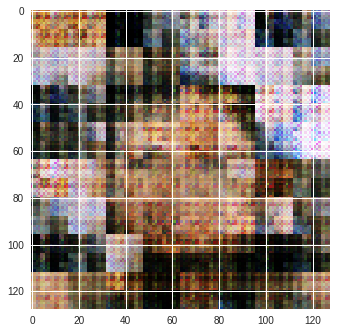

epoch:0,gloss:2.3223:  37%|███▋      | 8249/22511 [16:55<26:18,  9.04it/s]

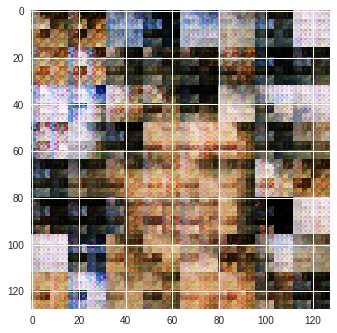

epoch:0,gloss:3.7969:  37%|███▋      | 8299/22511 [17:01<26:51,  8.82it/s]

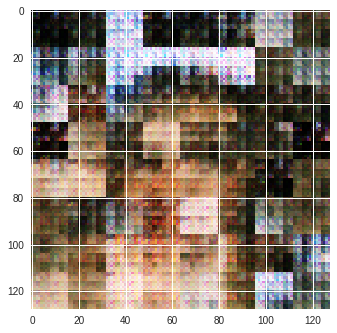

epoch:0,gloss:-0.9001:  37%|███▋      | 8349/22511 [17:07<26:33,  8.89it/s]

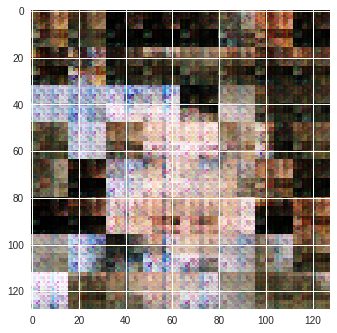

epoch:0,gloss:11.7832:  37%|███▋      | 8399/22511 [17:13<26:04,  9.02it/s]

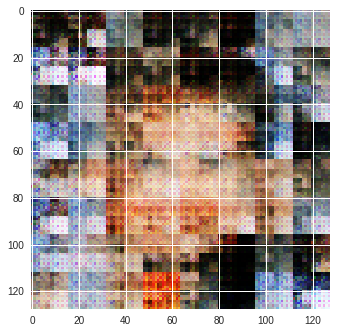

epoch:0,gloss:1.4121:  38%|███▊      | 8449/22511 [17:19<26:28,  8.85it/s]

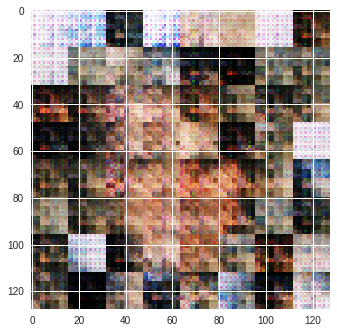

epoch:0,gloss:6.2870:  38%|███▊      | 8499/22511 [17:25<26:47,  8.71it/s]

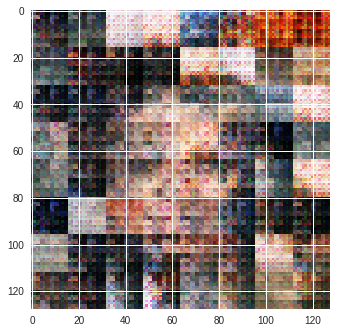

epoch:0,gloss:5.2997:  38%|███▊      | 8549/22511 [17:31<26:35,  8.75it/s]

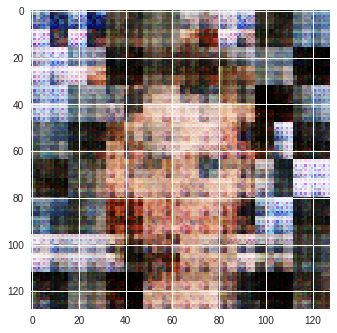

epoch:0,gloss:2.7529:  38%|███▊      | 8599/22511 [17:37<26:40,  8.69it/s]

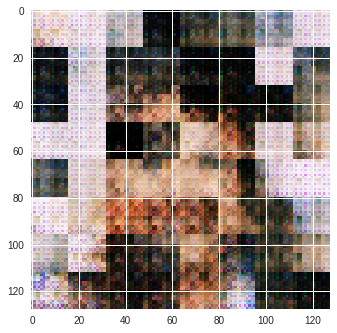

epoch:0,gloss:2.3974:  38%|███▊      | 8649/22511 [17:42<25:53,  8.92it/s]

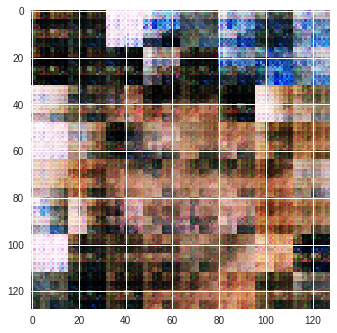

epoch:0,gloss:11.9480:  39%|███▊      | 8699/22511 [17:48<25:59,  8.86it/s]

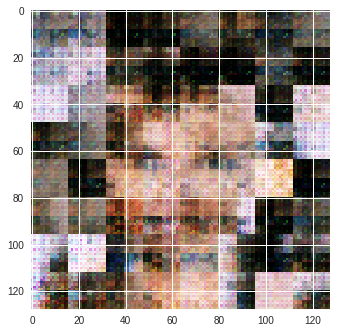

epoch:0,gloss:1.3217:  39%|███▉      | 8749/22511 [17:54<25:43,  8.92it/s]

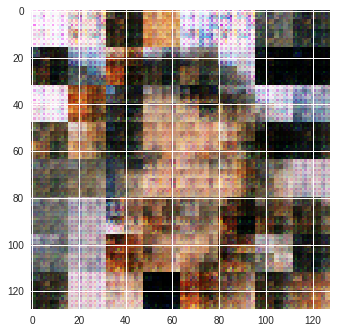

epoch:0,gloss:6.2739:  39%|███▉      | 8799/22511 [18:00<24:55,  9.17it/s]

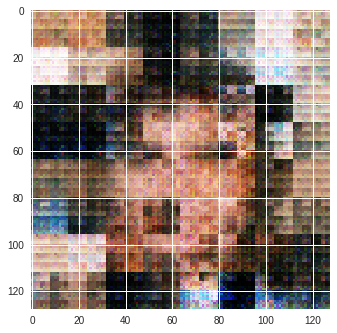

epoch:0,gloss:4.5792:  39%|███▉      | 8849/22511 [18:06<25:12,  9.03it/s]

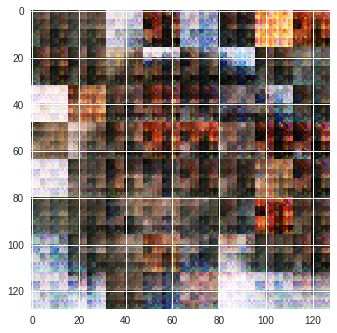

epoch:0,gloss:10.9704:  40%|███▉      | 8899/22511 [18:12<26:06,  8.69it/s]

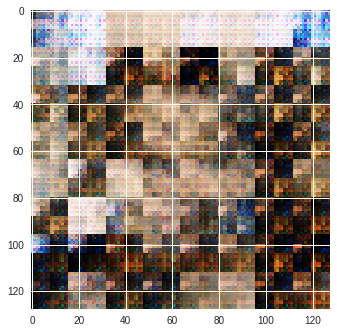

epoch:0,gloss:0.8830:  40%|███▉      | 8949/22511 [18:18<26:18,  8.59it/s] 

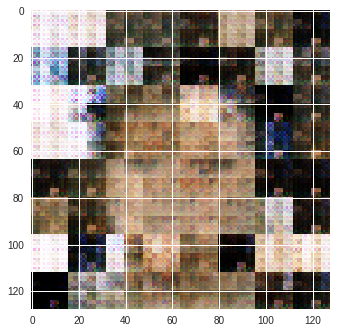

epoch:0,gloss:10.5160:  40%|███▉      | 8999/22511 [18:24<25:40,  8.77it/s]

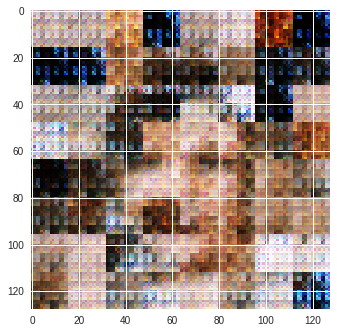

epoch:0,gloss:6.3409:  40%|████      | 9049/22511 [18:30<25:09,  8.92it/s]

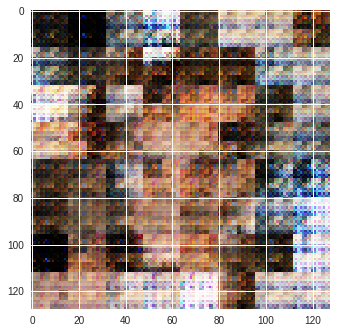

epoch:0,gloss:8.4244:  40%|████      | 9099/22511 [18:35<25:18,  8.83it/s]

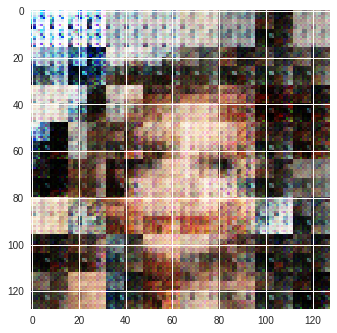

epoch:0,gloss:6.6557:  41%|████      | 9149/22511 [18:41<24:47,  8.98it/s]

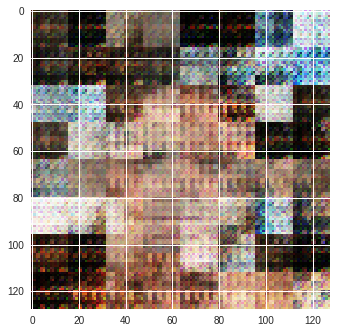

epoch:0,gloss:9.3134:  41%|████      | 9199/22511 [18:47<24:49,  8.94it/s]

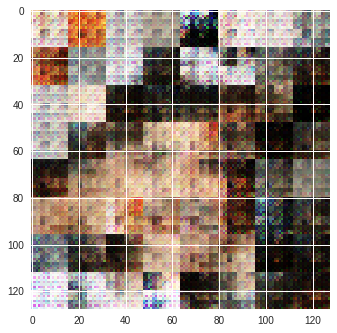

epoch:0,gloss:6.1973:  41%|████      | 9249/22511 [18:53<24:18,  9.09it/s]

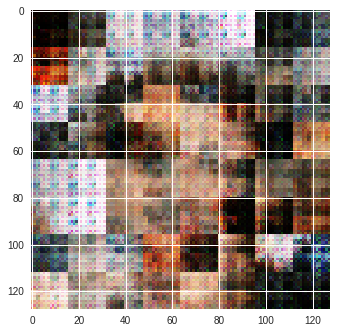

epoch:0,gloss:7.0641:  41%|████▏     | 9299/22511 [18:59<24:17,  9.06it/s]

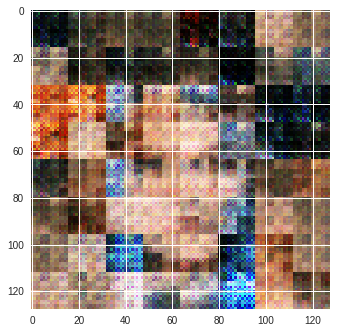

epoch:0,gloss:8.8625:  42%|████▏     | 9349/22511 [19:05<24:17,  9.03it/s]

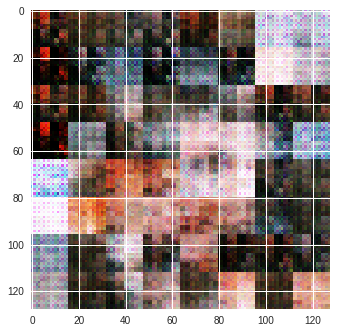

epoch:0,gloss:8.5260:  42%|████▏     | 9399/22511 [19:11<24:59,  8.74it/s]

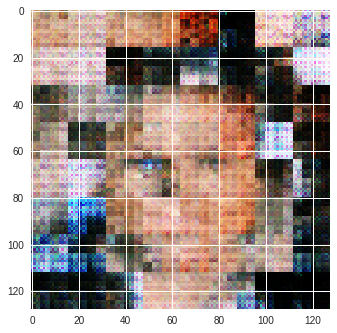

epoch:0,gloss:7.1287:  42%|████▏     | 9449/22511 [19:17<24:34,  8.86it/s]

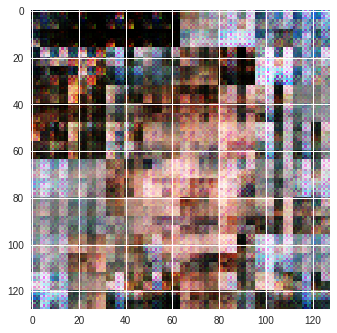

epoch:0,gloss:4.4643:  42%|████▏     | 9499/22511 [19:22<26:36,  8.15it/s]

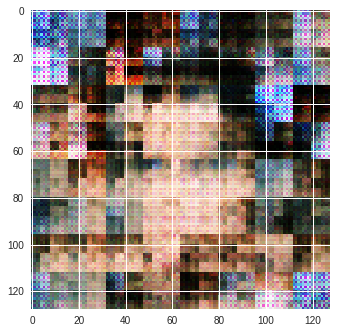

epoch:0,gloss:5.4236:  42%|████▏     | 9549/22511 [19:28<24:14,  8.91it/s]

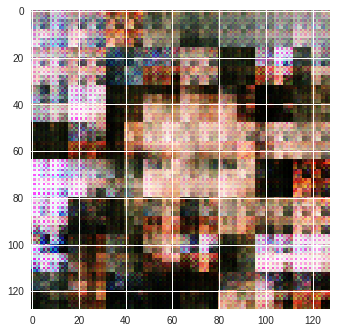

epoch:0,gloss:7.5513:  43%|████▎     | 9599/22511 [19:34<23:52,  9.01it/s]

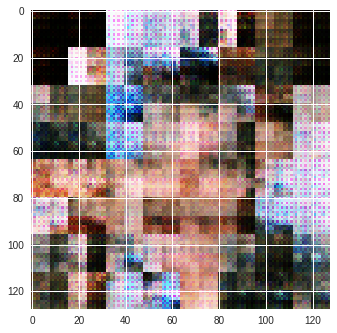

epoch:0,gloss:9.4851:  43%|████▎     | 9649/22511 [19:40<24:15,  8.84it/s]

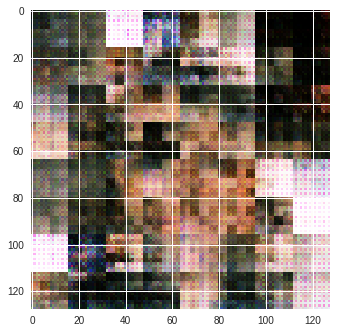

epoch:0,gloss:6.8253:  43%|████▎     | 9699/22511 [19:46<24:21,  8.76it/s]

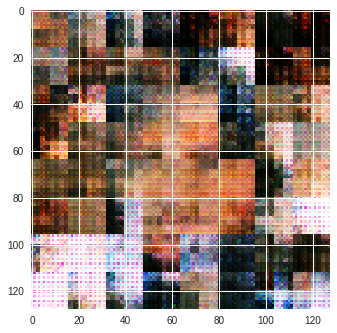

epoch:0,gloss:6.6119:  43%|████▎     | 9749/22511 [19:52<24:24,  8.71it/s]

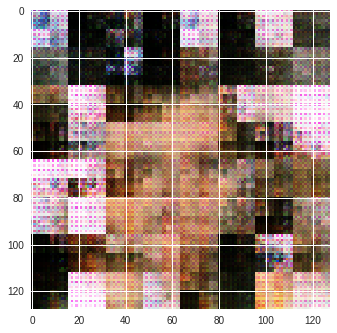

epoch:0,gloss:5.8549:  44%|████▎     | 9799/22511 [19:57<23:03,  9.19it/s]

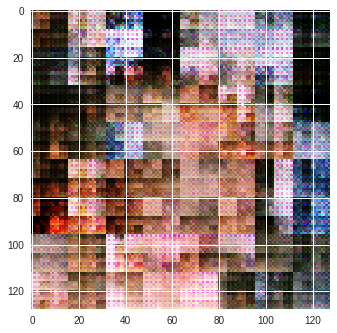

epoch:0,gloss:7.4078:  44%|████▍     | 9849/22511 [20:03<24:19,  8.67it/s]

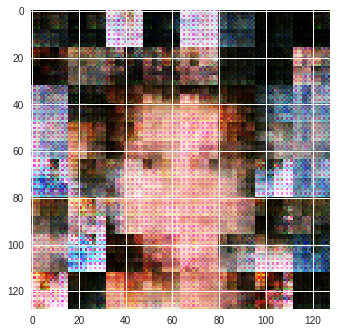

epoch:0,gloss:5.8262:  44%|████▍     | 9899/22511 [20:09<23:34,  8.92it/s]

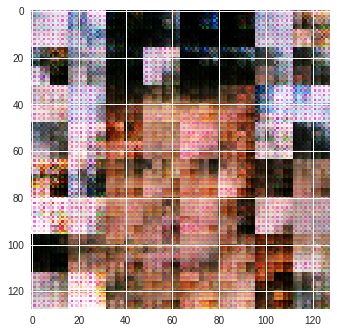

epoch:0,gloss:9.7925:  44%|████▍     | 9949/22511 [20:15<23:12,  9.02it/s]

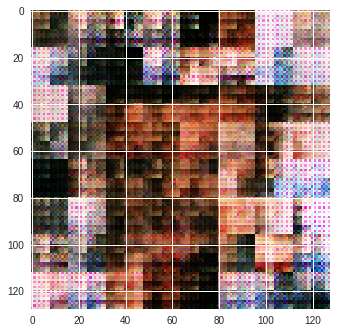

epoch:0,gloss:-0.6787:  44%|████▍     | 9999/22511 [20:21<23:19,  8.94it/s]

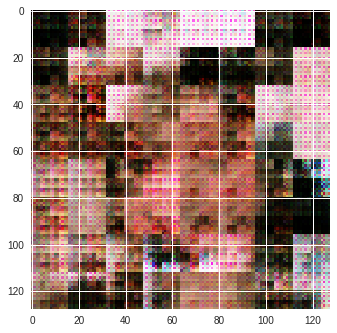

epoch:0,gloss:10.4015:  45%|████▍     | 10049/22511 [20:27<23:35,  8.80it/s]

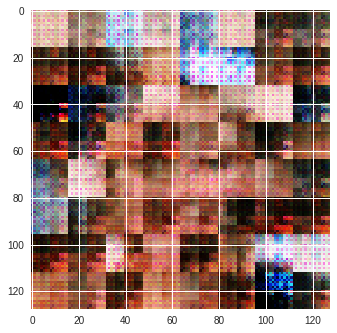

epoch:0,gloss:14.2303:  45%|████▍     | 10099/22511 [20:33<23:05,  8.96it/s]

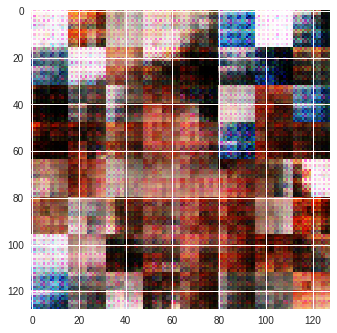

epoch:0,gloss:4.9589:  45%|████▌     | 10149/22511 [20:38<22:48,  9.03it/s]

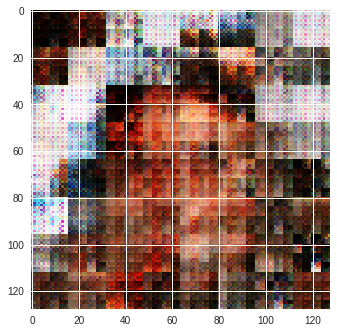

epoch:0,gloss:8.5572:  45%|████▌     | 10199/22511 [20:44<22:29,  9.12it/s]

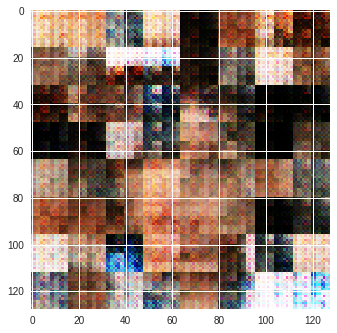

epoch:0,gloss:10.5805:  46%|████▌     | 10249/22511 [20:50<22:39,  9.02it/s]

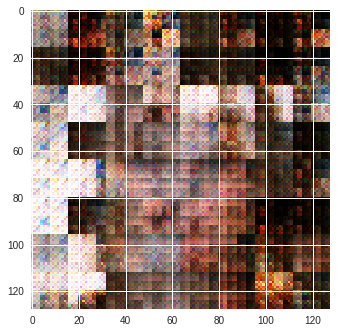

epoch:0,gloss:9.6397:  46%|████▌     | 10299/22511 [20:56<22:24,  9.09it/s] 

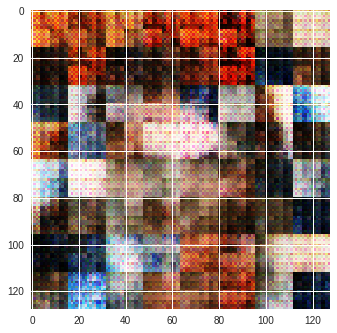

epoch:0,gloss:12.0086:  46%|████▌     | 10349/22511 [21:02<22:47,  8.89it/s]

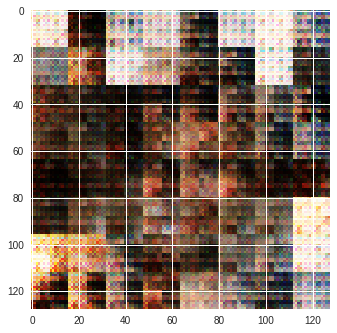

epoch:0,gloss:16.7317:  46%|████▌     | 10399/22511 [21:07<22:46,  8.86it/s]

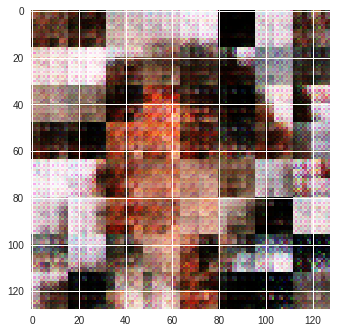

epoch:0,gloss:-4.3653:  46%|████▋     | 10449/22511 [21:13<22:31,  8.92it/s]

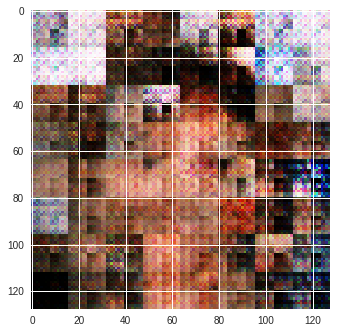

epoch:0,gloss:16.5941:  47%|████▋     | 10499/22511 [21:19<22:29,  8.90it/s]

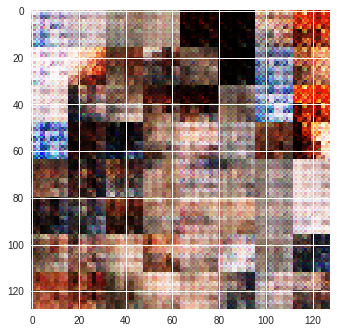

epoch:0,gloss:-4.5578:  47%|████▋     | 10549/22511 [21:25<22:24,  8.90it/s]

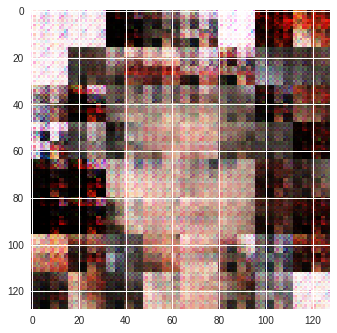

epoch:0,gloss:13.2984:  47%|████▋     | 10599/22511 [21:31<21:31,  9.22it/s]

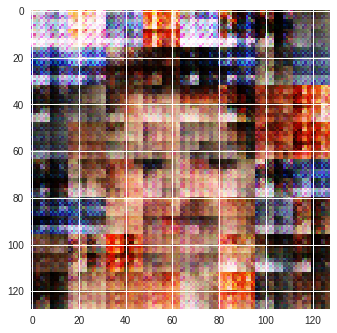

epoch:0,gloss:7.9081:  47%|████▋     | 10649/22511 [21:37<21:57,  9.01it/s] 

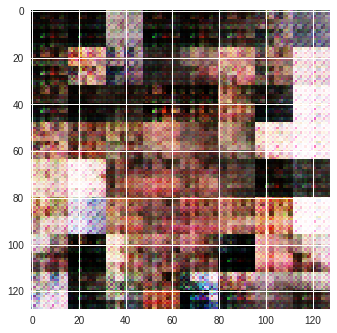

epoch:0,gloss:5.8002:  48%|████▊     | 10699/22511 [21:42<22:13,  8.86it/s]

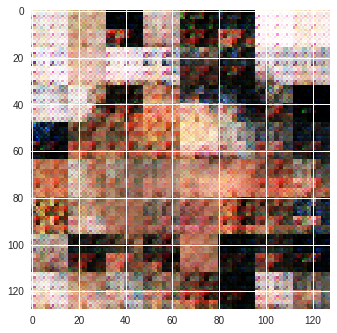

epoch:0,gloss:14.2881:  48%|████▊     | 10749/22511 [21:48<21:46,  9.00it/s]

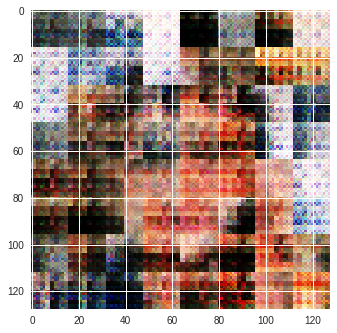

epoch:0,gloss:13.4689:  48%|████▊     | 10799/22511 [21:54<22:29,  8.68it/s]

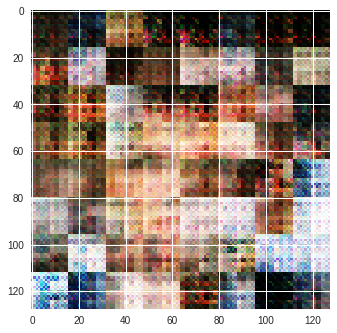

epoch:0,gloss:0.7050:  48%|████▊     | 10849/22511 [22:00<21:34,  9.01it/s]

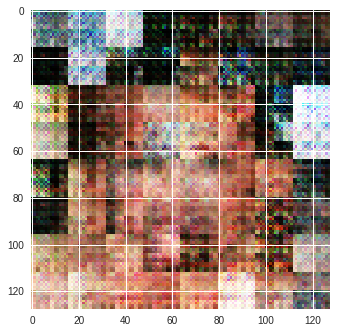

epoch:0,gloss:9.4214:  48%|████▊     | 10899/22511 [22:06<21:30,  9.00it/s]

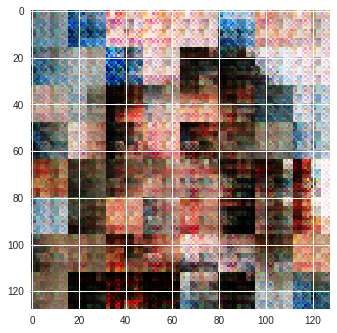

epoch:0,gloss:3.7311:  49%|████▊     | 10949/22511 [22:12<21:19,  9.04it/s]

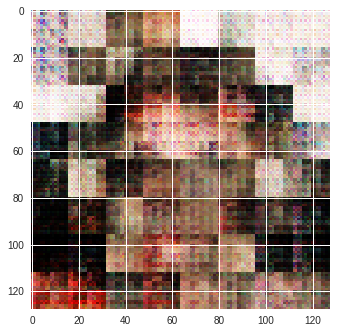

epoch:0,gloss:9.0711:  49%|████▉     | 10999/22511 [22:18<21:29,  8.92it/s]

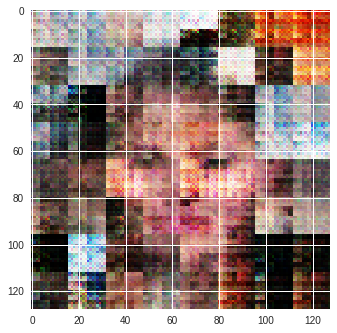

epoch:0,gloss:5.1311:  49%|████▉     | 11049/22511 [22:24<21:25,  8.92it/s]

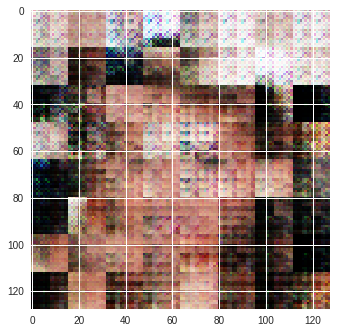

epoch:0,gloss:8.3413:  49%|████▉     | 11099/22511 [22:29<21:36,  8.80it/s]

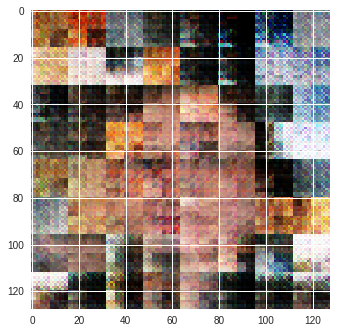

epoch:0,gloss:6.7974:  50%|████▉     | 11149/22511 [22:35<21:22,  8.86it/s]

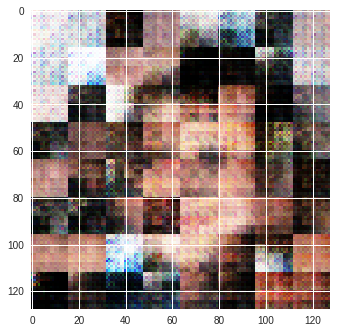

epoch:0,gloss:6.9835:  50%|████▉     | 11199/22511 [22:41<20:32,  9.18it/s]

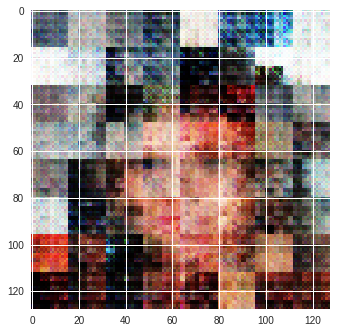

epoch:0,gloss:7.2001:  50%|████▉     | 11249/22511 [22:47<20:21,  9.22it/s]

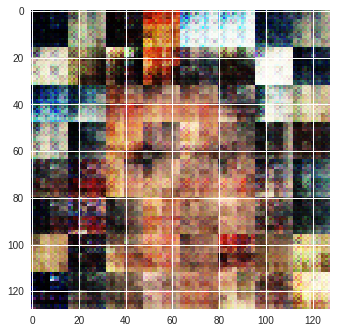

epoch:0,gloss:8.4562:  50%|█████     | 11299/22511 [22:53<21:07,  8.84it/s] 

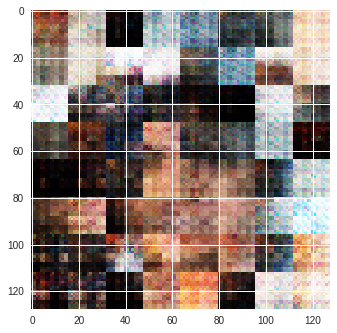

epoch:0,gloss:15.8861:  50%|█████     | 11349/22511 [22:59<20:45,  8.96it/s]

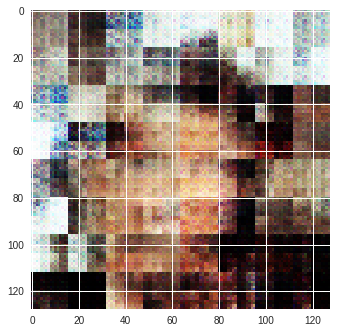

epoch:0,gloss:1.1237:  51%|█████     | 11399/22511 [23:04<20:43,  8.94it/s]

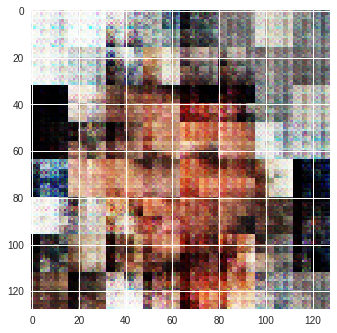

epoch:0,gloss:6.9454:  51%|█████     | 11449/22511 [23:10<20:37,  8.94it/s]

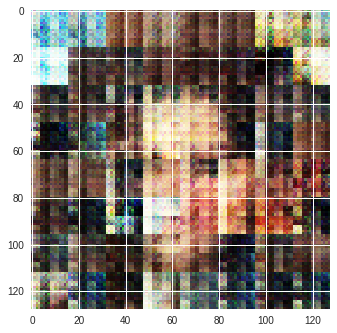

epoch:0,gloss:13.9247:  51%|█████     | 11499/22511 [23:16<19:57,  9.20it/s]

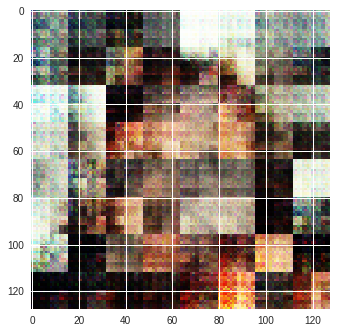

epoch:0,gloss:4.4771:  51%|█████▏    | 11549/22511 [23:22<20:25,  8.95it/s]

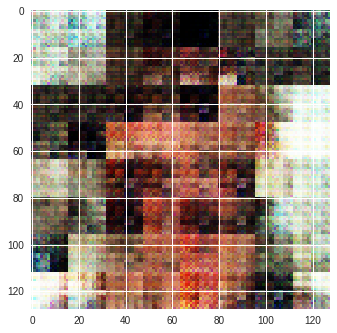

epoch:0,gloss:14.5415:  52%|█████▏    | 11599/22511 [23:28<20:36,  8.83it/s]

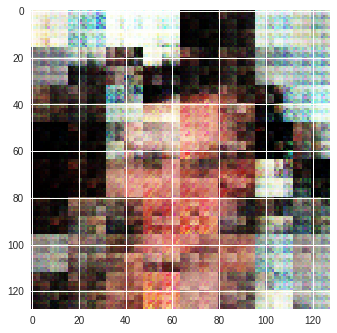

epoch:0,gloss:7.1999:  52%|█████▏    | 11649/22511 [23:34<20:01,  9.04it/s]

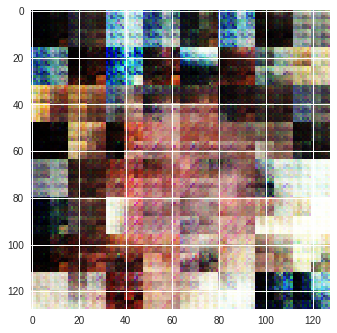

epoch:0,gloss:7.6471:  52%|█████▏    | 11699/22511 [23:40<20:17,  8.88it/s]

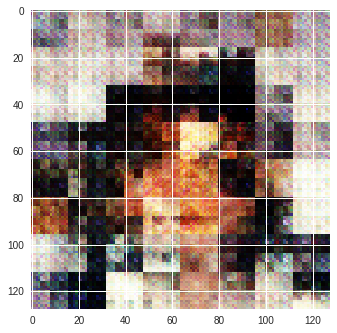

epoch:0,gloss:11.6310:  52%|█████▏    | 11749/22511 [23:46<20:28,  8.76it/s]

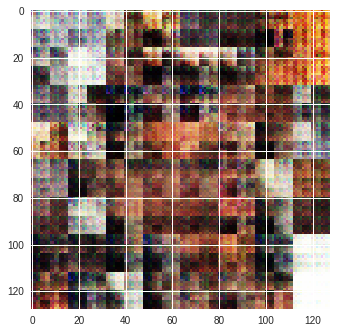

epoch:0,gloss:7.2494:  52%|█████▏    | 11799/22511 [23:52<20:20,  8.77it/s]

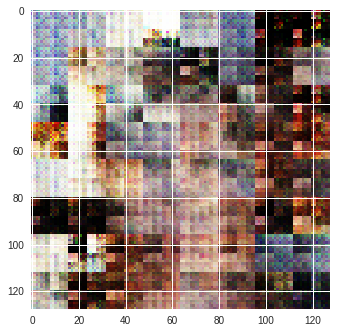

epoch:0,gloss:0.5425:  53%|█████▎    | 11849/22511 [23:57<20:17,  8.76it/s]

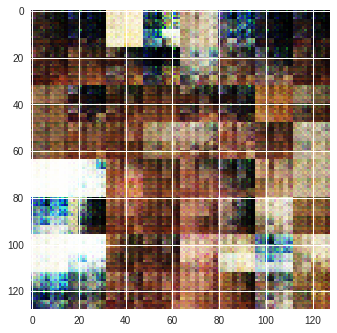

epoch:0,gloss:14.9065:  53%|█████▎    | 11899/22511 [24:03<19:56,  8.87it/s]

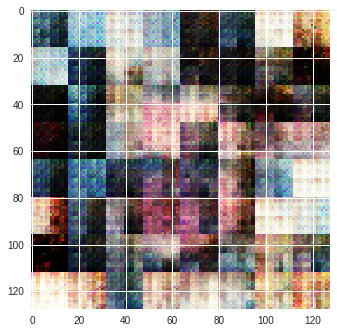

epoch:0,gloss:4.4132:  53%|█████▎    | 11949/22511 [24:09<20:00,  8.79it/s]

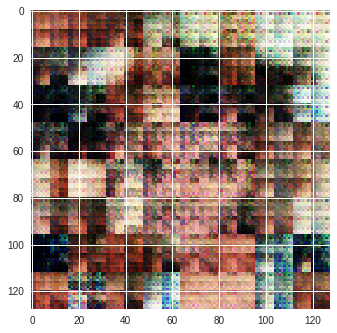

epoch:0,gloss:15.3336:  53%|█████▎    | 11999/22511 [24:15<19:43,  8.88it/s]

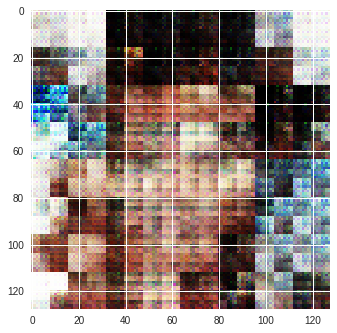

epoch:0,gloss:2.5559:  54%|█████▎    | 12049/22511 [24:21<19:07,  9.12it/s] 

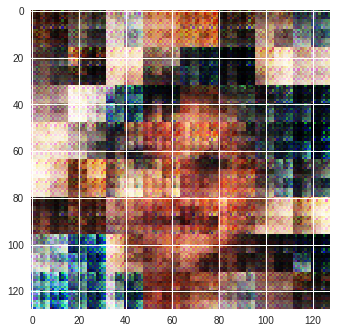

epoch:0,gloss:9.6412:  54%|█████▎    | 12099/22511 [24:27<19:49,  8.75it/s] 

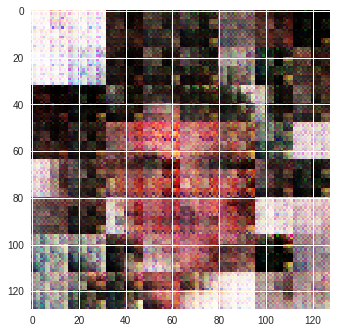

epoch:0,gloss:7.1914:  54%|█████▍    | 12149/22511 [24:33<18:57,  9.11it/s]

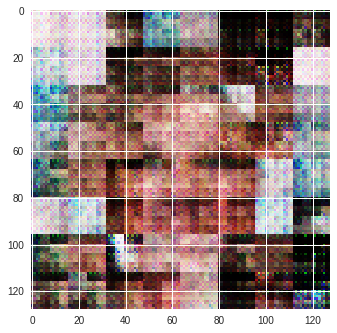

epoch:0,gloss:0.1030:  54%|█████▍    | 12199/22511 [24:38<19:07,  8.99it/s] 

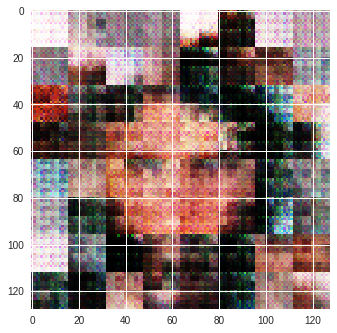

epoch:0,gloss:11.1323:  54%|█████▍    | 12249/22511 [24:44<18:43,  9.14it/s]

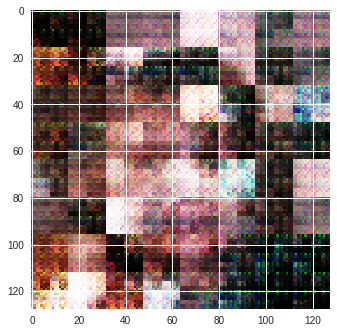

epoch:0,gloss:13.7856:  55%|█████▍    | 12299/22511 [24:50<18:30,  9.19it/s]

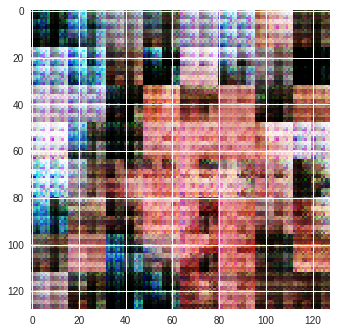

epoch:0,gloss:8.0573:  55%|█████▍    | 12349/22511 [24:56<18:28,  9.17it/s]

KeyboardInterrupt: ignored

In [12]:
#initialize your generator and discriminator models
 
#initialize separate optimizer for both gen and disc
 
#initialize your dataset and dataloader


train_dataset = CelebaDataset('./test' )
lam = 10
disc_model = discriminator()
disc_model = disc_model.cuda()
gen_model = generator()
gen = gen_model.cuda()
epochs = range(7)


beta1 = 0.5 # 0
beta2 = 0.999 # 0.9
learning_rate = 0.0002
gen_optim = optim.Adam(gen_model.parameters(), betas=(beta1, beta2), lr=learning_rate)
disc_optim = optim.Adam(disc_model.parameters(), betas=(beta1, beta2), lr=learning_rate)
critic_iters = 1

batch_norm_decay=0.9
batch_norm_epsilon=1e-5
batchsize = 9
count = 0

alpha = .0001
trainloader = DataLoader(train_dataset,
                         batch_size=batchsize,
                         pin_memory=True, shuffle=True)


for e in epochs:
  loop = tqdm(total=len(trainloader), position=0, leave=False)
  for true_img in trainloader:
    count = count + 1
    true_img = true_img.cuda(async=True)
 
    #train discriminator#
 
    #because you want to be able to backprop through the params in discriminator 
    for p in disc_model.parameters():
      p.requires_grad = True
 
    for p in gen_model.parameters():
      p.requires_grad = False
 
    for n in range(critic_iters):
      disc_optim.zero_grad()
      z = torch.randn(batchsize, 100)
      z = z.cuda(async=True)
      x_tilda = gen_model(z)
      
      
      epsilon = torch.rand(batchsize)
      epsilon = epsilon.view(-1,1,1,1)
      epsilon = epsilon.cuda(async=True)
      
      
      
      x_hat = true_img + x_tilda
      

       
      for i in range(batchsize):
        x_hat[i] = epsilon[i]*true_img[i] + (1-epsilon[i])*x_tilda[i]
      #print(x_hat.shape)
        

        
      #x_hat = epsilon*true_img + (1-epsilon)*x_tilda
      x_hat.requires_grad = True

      
      gradient = torch.autograd.grad(disc_model(x_hat).mean(), x_hat, create_graph=True)

      
      dloss = disc_model(x_tilda) - disc_model(true_img) + lam*((gradient[0].norm(2)-1)**2)

 
      # generate noise tensor z
      # calculate disc loss: you will need autograd.grad
    

      # call dloss.backward() and disc_optim.step()
      dloss.mean().backward()
      disc_optim.step()
      
 
    #train generator#
    for p in disc_model.parameters():
      p.requires_grad = False
 
    for p in gen_model.parameters():
      p.requires_grad = True
 
    gen_optim.zero_grad()
 
    # generate noise tensor z
    z = torch.randn(batchsize, 100)
    z = z.cuda(async=True)
    # calculate loss for gen
    
    gloss = -disc_model(gen_model(z)).mean()
    # call gloss.backward() and gen_optim.step()
    gloss.backward()
    
    loop.set_description(
            'epoch:{},gloss:{:.4f}'.format(e,gloss))
    #loop.close()
    if count%50 == 0:
      z = torch.randn(100)
      z = z.cuda(async=True)
      x = gen_model(z)
     
      plt.imshow(display(x.squeeze(0).detach()))
      plt.show()
      

    loop.update(1)
    gen_optim.step()
 

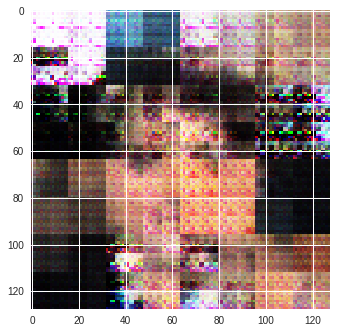

In [51]:
def display(x):
  return np.dstack((x[0], x[1], x[2]))
z = torch.randn(100)
z = z.cuda(async=True)
x = gen_model(z)


plt.imshow(display(x.squeeze(0).detach()))

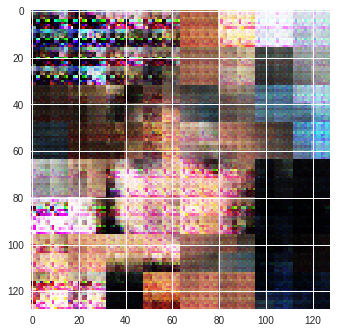

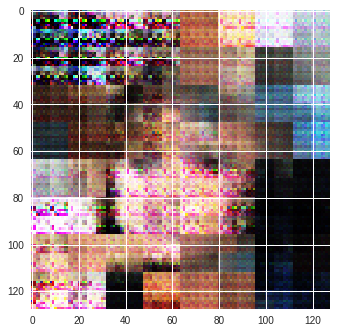

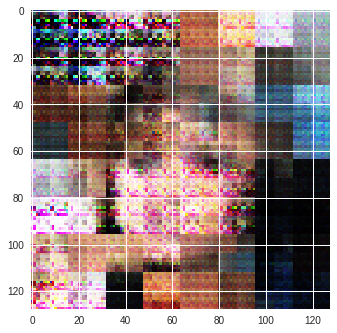

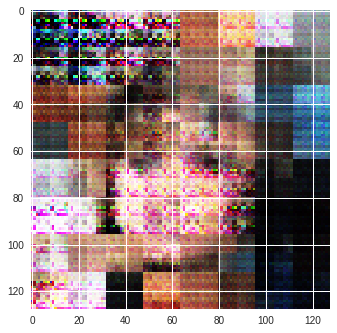

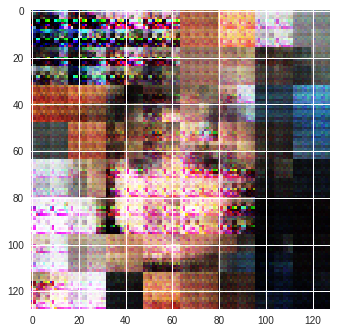

...

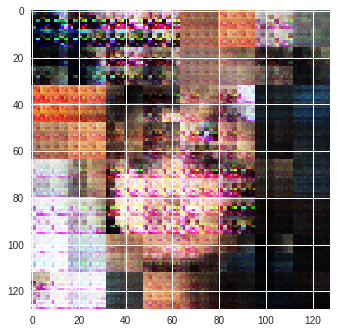

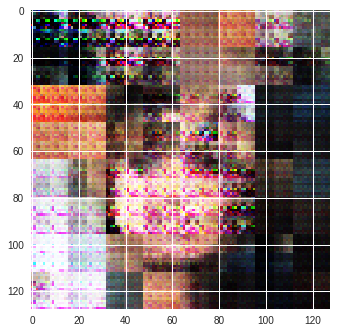

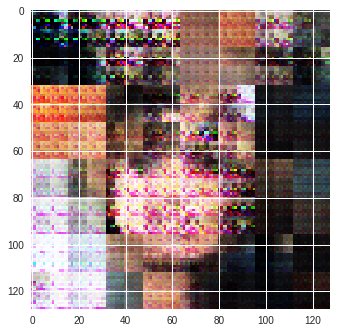

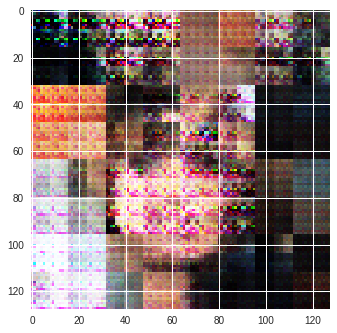

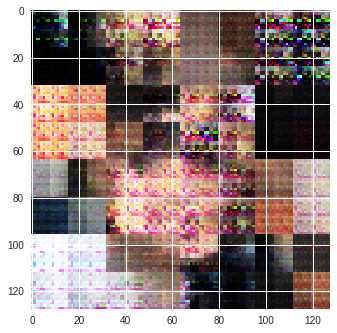

In [48]:
z1 = torch.randn(100)
z1 = z1.cuda(async=True)
x = gen_model(z1)
plt.imshow(display(x.squeeze(0).detach()))
plt.show()
z2 = torch.randn(100)
z2 = z2.cuda(async=True)
for i in range(10):
  z1 = z1 + (z2 - z1)/10
  z1 = z1.cuda(async=True)
  
  x = gen_model(z1)
  plt.imshow(display(x.squeeze(0).detach()))
  plt.show()

x = gen_model(z2)
plt.imshow(display(x.squeeze(0).detach()))
plt.show()



In [38]:
for i in range(1,202599):
  if len(train_dataset)%i == 0:
    print(i)
    
print(len(train_dataset))

1
3
9
22511
67533
202599
